In [ ]:
import pandas as pd
from psycopg2.extras import execute_batch
import random
from datetime import timedelta
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.ticker import FuncFormatter
import folium
import requests


## Constants

In [2]:

RIDER_RATIO = 0.75
MIN_TRIP_DISTANCE_METERS = 6000
AVG_TRIP_DISTANCE_METERS = 18170 #22330
MAX_TRIP_DISTANCE_METERS = 25000


# Rider time tolerande
RIDER_DETOUR_VALUES = [0, 10, 15, 20, 25]
RIDER_DETOUR_WEIGHTS = [0.0425, 0.4434, 0.3302, 0.1085, 0.0755]
#walking time
WALKING_DURATION_VALUES = [0, 5, 10, 15, 20,]  
WALKING_DURATION_WEIGHTS = [0.0095, 0.4571, 0.3571, 0.0905, 0.0085]
#passenger per request
RIDERS_PER_REQUEST_VALUES = [1, 2, 3]
RIDERS_PER_REQUEST_WEIGHTS = [0.6509, 0.2925, 0.0566]

# Driver detour
DRIVER_DETOUR_VALUES = [0, 10, 15, 20, 25]
DRIVER_DETOUR_WEIGHTS = [0.2745, 0.4314, 0.1765, 0.0784, 0.0392]

# car capacity
DRIVER_CAPACITY_VALUES = [1, 2, 3]
DRIVER_CAPACITY_WEIGHTS = [0.0847, 0.2542, 0.661]

# Gender preferences
FEMALE_SAME_GENDER_WEIGHTS = [0.7703, 0.2297]  # [True, False]
MALE_SAME_GENDER_WEIGHTS = [0.6159, 0.3841]    # [True, False]

# male to female dirver ratio
DRIVER_GENDER_WEIGHTS = [0.6471, 0.3529]      # [male, female]
# male to female rider ratio
RIDER_GENDER_WEIGHTS = [0.6522, 0.3478]       # [male, female]

# AVERAGE_SPEED_KMH_SF = 26
# AVERAGE_SPEED_KMH_SF = 26

In [ ]:
AVERAGE_SPEED_KMH = 30.5
CURR_VALHALLA_PORT=8004
OSRM_URL = "https://000954eee81b.ngrok-free.app/route/v1/driving"
CURR_VALHALLA_IP = "68.221.112.34"


## Functions

In [4]:
def plot_distribution(df, column, x_unit, x_factor=1, lower_quantile=0.01, upper_quantile=0.99, bins=30,y_unit='',y_factor=1):
    """
    Plots the distribution of a specified column in a DataFrame,
    focusing on the majority of the values by trimming outliers based on quantiles.
    
    Parameters:
        df (DataFrame): The input dataset.
        column (str): The column to plot.
        lower_quantile (float): Lower quantile for trimming (default 1%).
        upper_quantile (float): Upper quantile for trimming (default 99%).
        bins (int): Number of bins in the histogram.
    """
    # Drop NaN values
    data = df[column].dropna()
    
    # Compute quantile range
    lower_bound = data.quantile(lower_quantile)
    upper_bound = data.quantile(upper_quantile)
    
    # Filter data within quantile range
    filtered_data = data[(data >= lower_bound) & (data <= upper_bound)]
    
    # Plot
    plt.figure(figsize=(10, 6))
    # sns.histplot(filtered_data, bins=bins, kde=True, color='skyblue')
    sns.histplot(filtered_data, bins=bins, kde=True, color='skyblue', stat='density')

    plt.title(f'Distribution of {column} (Focused on {lower_quantile*100:.0f}%-{upper_quantile*100:.0f}%)')
    plt.xlabel(column)
    plt.ylabel('Frequency')
    plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda x, _: f'{int(x/y_factor)}{y_unit}'))

    # Format x-axis to show values in 'minutes' instead of 'seconds'
    plt.gca().xaxis.set_major_formatter(FuncFormatter(lambda x, _: f'{int(x * x_factor)} {x_unit}'))
    plt.grid(True, linestyle='--', alpha=0.5)
    plt.show()

### osrm

In [ ]:
def get_travel_time_and_distance_osrm(src_lat, src_lon, dst_lat, dst_lon, departure_time=None):
    """
    Gets the travel time and distance between two coordinates using OSRM routing service
    """
    
    
    # OSRM expects lon,lat format
    coordinates = f"{src_lon},{src_lat};{dst_lon},{dst_lat}"
    
    url = f"{OSRM_URL}/{coordinates}"
    params = {
        "overview": "false",
        "annotations": "duration,distance"
    }
    
    try:
        response = requests.get(url, params=params, timeout=30)
        
        if response.status_code == 200:
            data = response.json()
            
            if data.get("code") == "Ok" and data.get("routes"):
                route = data["routes"][0]
                travel_time_seconds = route["duration"]  # seconds
                distance_m = route["distance"]  # meters
                
                return travel_time_seconds, distance_m
            else:
                raise Exception(f"OSRM routing error: {data.get('message', 'No route found')}")
        else:
            raise Exception(f"HTTP error: {response.status_code}")
            
    except requests.exceptions.RequestException as e:
        raise Exception(f"OSRM request failed: {str(e)}")

# # Example usage
# if __name__ == "__main__":
#     # Example coordinates for San Francisco
#     source = (37.7749, -122.4194)      # San Francisco downtown
#     destination = (37.8199, -122.4783) # Golden Gate Bridge
    
#     # Get travel time and distance
#     travel_time, distance = get_travel_time_and_distance(
#         source[0], source[1],
#         destination[0], destination[1]
#     )
    
#     print(f"Travel time: {travel_time:.1f} minutes")
#     print(f"Distance: {distance:.2f} km")

In [41]:
def get_batch_distances_osrm(sources, destinations, departure_time=None):
    """
    Gets travel times and distances between multiple sources and destinations using OSRM.
    
    Parameters:
        sources: List of (lat, lon) tuples for source locations
        destinations: List of (lat, lon) tuples for destination locations
        departure_time (datetime, optional): Departure time (ignored for OSRM)
        
    Returns:
        list: List of lists containing (travel_time_seconds, distance_m) for each source-destination pair
    """
    # OSRM table API endpoint - adjust the URL to your OSRM server
    # OSRM_URL  # Public OSRM server
    # For local OSRM server, use: "http://localhost:5000/table/v1/driving"
    
    # Build coordinates string for OSRM (lon,lat format)
    all_coordinates = []
    
    # Add sources first
    for lat, lon in sources:
        all_coordinates.append(f"{lon},{lat}")
    
    # Add destinations
    for lat, lon in destinations:
        all_coordinates.append(f"{lon},{lat}")
    
    coordinates_str = ";".join(all_coordinates)
    
    # Create sources and destinations indices
    sources_indices = list(range(len(sources)))
    destinations_indices = list(range(len(sources), len(sources) + len(destinations)))
    
    # Build OSRM request URL
    url = f"{OSRM_URL}/{coordinates_str}"
    params = {
        "sources": ";".join(map(str, sources_indices)),
        "destinations": ";".join(map(str, destinations_indices)),
        "annotations": "duration,distance"
    }
    
    try:
        response = requests.get(url, params=params, timeout=30)
        
        if response.status_code == 200:
            data = response.json()
            
            if data.get("code") == "Ok":
                durations = data.get("durations", [])
                distances = data.get("distances", [])
                
                results = []
                
                # Process results for each source
                for source_idx in range(len(sources)):
                    source_results = []
                    
                    for dest_idx in range(len(destinations)):
                        duration = durations[source_idx][dest_idx] if durations else None
                        distance = distances[source_idx][dest_idx] if distances else None
                        
                        if duration is not None and distance is not None:
                            # OSRM returns duration in seconds and distance in meters
                            travel_time_seconds = duration
                            distance_m = distance
                            source_results.append((travel_time_seconds, distance_m))
                        else:
                            # Handle unreachable destinations
                            source_results.append((None, None))
                    
                    results.append(source_results)
                
                return results
            else:
                raise Exception(f"OSRM API error: {data.get('message', 'Unknown error')}")
        else:
            raise Exception(f"HTTP error: {response.status_code} - {response.text}")
            
    except requests.exceptions.Timeout:
        raise Exception("OSRM request timed out")
    except requests.exceptions.RequestException as e:
        raise Exception(f"OSRM request failed: {str(e)}")

# Example usage
# if __name__ == "__main__":
#     # Example coordinates
#     sources = [
#         (37.7749, -122.4194),  # San Francisco downtown
#         (37.7749, -122.4294)   # Another location in SF
#     ]
    
#     destinations = [
#         (37.8199, -122.4783),  # Golden Gate Bridge
#         (37.8044, -122.2712),  # Downtown Oakland
#         (37.7339, -122.4170)   # Mission District
#     ]
    
#     # Get batch travel times and distances
#     results = get_batch_distances(sources, destinations)
    
#     # Print results
#     for i, source in enumerate(sources):
#         print(f"\nSource {i+1}: {source}")
#         for j, dest in enumerate(destinations):
#             time, dist = results[i][j]
#             if time is not None:
#                 print(f"  To Destination {j+1} {dest}: {time:.1f} minutes, {dist/1000:.2f} km")
#             else:
#                 print(f"  To Destination {j+1} {dest}: Unreachable")


In [8]:
def add_osrm_data_batched(df,
                              batch_size=100,
                              average_speed_kmh=AVERAGE_SPEED_KMH,
                            osrm_column_name='osrm_distance_m'
                              ):
   

    # Make a copy to avoid modifying the original
    df_result = df.copy()
    
    # Add new columns
    df_result[osrm_column_name] = None
    df_result['osrm_time_seconds'] = None
    
    total_rows = len(df_result)
    print(f"Processing {total_rows} rows in batches of {batch_size}")
    
    # Process the dataframe in batches
    for batch_start in range(0, total_rows, batch_size):
        batch_end = min(batch_start + batch_size, total_rows)
        batch = df_result.iloc[batch_start:batch_end]
        
        print(f"Processing batch {batch_start//batch_size + 1}: rows {batch_start} to {batch_end-1}")
        
        # Extract sources and destinations for this batch
        sources = []
        destinations = []
        
        for _, row in batch.iterrows():
            sources.append((row['pickup_latitude'], row['pickup_longitude']))
            destinations.append((row['dropoff_latitude'], row['dropoff_longitude']))
        
        # Use the first row's start time for the batch
        departure_time = batch.iloc[0]['start_time'] if len(batch) > 0 else None
        
        try:
            # Get travel times and distances for the entire batch
            batch_results = get_batch_distances_osrm(sources, destinations, departure_time)
            
            # Update the dataframe with the results
            for i, (idx, row) in enumerate(batch.iterrows()):
                # Each batch_results[i][i] contains the (travel_time, distance) for the i-th source to i-th destination
                travel_time_seconds, distance_m = batch_results[i][i]
                
                if travel_time_seconds is not None and distance_m is not None:
                    df_result.at[idx, osrm_column_name] = distance_m 
                    df_result.at[idx, 'osrm_time_seconds'] = travel_time_seconds
                    
                    # Calculate new end_time
                    start_dt = row['start_time']
                    new_end_dt = start_dt + timedelta(seconds=travel_time_seconds)
                    
                    # Update end_time
                    df_result.at[idx, 'end_time'] = new_end_dt
                else:
                    print(f"Warning: No route found for row {idx}, using fallback calculation")
                    # Fall back to estimation using original distance
                    distance_m_fallback = row['trip_distance_meters'] if 'trip_distance_meters' in row else 0
                    travel_time_minutes = (distance_m_fallback / 1000 / average_speed_kmh) * 60
                    
                    df_result.at[idx, osrm_column_name] = distance_m_fallback
                    df_result.at[idx, 'osrm_time_seconds'] = travel_time_minutes * 60
                    
                    start_dt = row['start_time']
                    new_end_dt = start_dt + timedelta(minutes=travel_time_minutes)
                    df_result.at[idx, 'end_time'] = new_end_dt
                    
        except Exception as e:
            print(f"Error processing batch {batch_start}-{batch_end}: {e}")
            print(f"Exception type: {type(e).__name__}")
            print(f"Exception details: {str(e)}")
            
            # Process each row individually as fallback
            for idx, row in batch.iterrows():
                try:
                    src_lat = row['pickup_latitude']
                    src_lon = row['pickup_longitude']
                    dst_lat = row['dropoff_latitude']
                    dst_lon = row['dropoff_longitude']
                    start_dt = row['start_time']
                    
                    travel_time_seconds, distance_m = get_travel_time_and_distance_osrm(
                        src_lat, src_lon, dst_lat, dst_lon, start_dt
                    )
                    
                    if travel_time_seconds is not None and distance_m is not None:
                        df_result.at[idx, osrm_column_name] = distance_m
                        df_result.at[idx, 'osrm_time_seconds'] = travel_time_seconds
                        
                        new_end_dt = start_dt + timedelta(seconds=travel_time_seconds)
                        df_result.at[idx, 'end_time'] = new_end_dt
                    else:
                        # This is the fixed fallback section
                        print(f"Warning: No route found for individual row {idx}, using distance estimation")
                        distance_m_fallback = row['trip_distance_meters'] if 'trip_distance_meters' in row else 10000  # Default 10km
                        travel_time_minutes = (distance_m_fallback / 1000 / average_speed_kmh) * 60
                        
                        df_result.at[idx, osrm_column_name] = distance_m_fallback
                        df_result.at[idx, 'osrm_time_seconds'] = travel_time_minutes * 60
                        
                        new_end_dt = start_dt + timedelta(minutes=travel_time_minutes)
                        df_result.at[idx, 'end_time'] = new_end_dt
                        
                except Exception as e:
                    print(f"Error processing individual row {idx}: {e}")
                    
                    # Final fallback to simple estimation
                    distance_m_fallback = row.get('trip_distance_meters', 10000)  # Use .get() with default
                    travel_time_minutes = (distance_m_fallback / 1000 / average_speed_kmh) * 60
                    
                    df_result.at[idx, osrm_column_name] = distance_m_fallback
                    df_result.at[idx, 'osrm_time_seconds'] = travel_time_minutes * 60
                    
                    start_dt = row['start_time']
                    new_end_dt = start_dt + timedelta(minutes=travel_time_minutes)
                    df_result.at[idx, 'end_time'] = new_end_dt
    
    print(f"Completed processing {total_rows} rows")
    return df_result

### valhalla

In [ ]:
def get_travel_time_and_distance(src_lat, src_lon, dst_lat, dst_lon, departure_time=None):
    """
    Gets the travel time and distance between two coordinates using Valhalla routing service
    
    Parameters:
        src_lat (float): Source latitude
        src_lon (float): Source longitude
        dst_lat (float): Destination latitude
        dst_lon (float): Destination longitude
        departure_time (datetime, optional): Departure time (can be None for current time)
        
    Returns:
        tuple: (travel_time_minutes, distance_km)
    """
    # Valhalla API endpoint
    url = f"http://{CURR_VALHALLA_IP}:{CURR_VALHALLA_PORT}/route"
    
    # Build request payload
    locations = [
        {"lat": src_lat, "lon": src_lon},
        {"lat": dst_lat, "lon": dst_lon}
    ]
    
    # Add departure time if specified
    if departure_time:
        locations[0]["date_time"] = {
            "type": 1,  # 1 = departure time
            "value": departure_time.strftime("%Y-%m-%dT%H:%M")
        }
    
    # Create request payload
    payload = {
        "locations": locations,
        "costing": "auto",
        "costing_options": {
            "auto": {
                "shortest": False,  # Use fastest route
                "fixed_speed": AVERAGE_SPEED_KMH 
            }
        },
        "units": "kilometers",
        "language": "en-US",
        "format": "json"
    }
    
    # Make the HTTP request
    response = requests.post(url, json=payload)
    
    # Parse the response
    if response.status_code == 200:
        data = response.json()
        summary = data["trip"]["summary"]
        
        # Get time in minutes (Valhalla returns time in seconds)
        travel_time_seconds = summary["time"] 
        
        # Get distance in kilometers
        distance_m = summary["length"] * 1000
        
        return travel_time_seconds, distance_m
    else:
        raise Exception(f"Error requesting route: {response.status_code} - {response.text} src_lat: {src_lat}, src_lon: {src_lon}, dst_lat: {dst_lat}, dst_lon: {dst_lon}")

# # Example usage
# if __name__ == "__main__":
#     # Example coordinates for San Francisco
#     source = (37.7749, -122.4194)      # San Francisco downtown
#     destination = (37.8199, -122.4783) # Golden Gate Bridge
    
#     # Get travel time and distance
#     travel_time, distance = get_travel_time_and_distance(
#         source[0], source[1],
#         destination[0], destination[1]
#     )
    
#     print(f"Travel time: {travel_time:.1f} minutes")
#     print(f"Distance: {distance:.2f} km")

In [ ]:
def get_batch_distances(sources, destinations, departure_time=None):
    """
    Gets travel times and distances between multiple sources and destinations using Valhalla.
    
    Parameters:
        sources: List of (lat, lon) tuples for source locations
        destinations: List of (lat, lon) tuples for destination locations
        departure_time (datetime, optional): Departure time (can be None for current time)
        
    Returns:
        list: List of lists containing (travel_time_minutes, distance_m) for each source-destination pair
    """
    # Valhalla matrix API endpoint
    url = f"http://{CURR_VALHALLA_IP}:{CURR_VALHALLA_PORT}/sources_to_targets"
    
    # Build sources and targets lists
    sources_list = [{"lat": lat, "lon": lon} for lat, lon in sources]
    targets_list = [{"lat": lat, "lon": lon} for lat, lon in destinations]
    
    # Add departure time if specified
    if departure_time:
        # Add to each source
        for source in sources_list:
            source["date_time"] = {
                "type": 1,  # 1 = departure time
                "value": departure_time.strftime("%Y-%m-%dT%H:%M")
            }
    
    # Create request payload
    payload = {
        "sources": sources_list,
        "targets": targets_list,
        "costing": "auto",
        "costing_options": {
            "auto": {
                "shortest": False,  # Use fastest route
                "fixed_speed": AVERAGE_SPEED_KMH
            }
        },
        "units": "kilometers",
        "format": "json"
    }
    
    # Make the HTTP request
    response = requests.post(url, json=payload)
    
    # Parse the response
    if response.status_code == 200:
        data = response.json()
        
        # Extract the results - the response will contain a matrix of results
        # for each source-target pair
        results = []
        
        for source_idx, source_data in enumerate(data["sources_to_targets"]):
            source_results = []
            for target_idx, target_data in enumerate(source_data):
                if "time" in target_data and "distance" in target_data:
                    # Convert time to minutes (Valhalla returns time in seconds)
                    travel_time_seconds = target_data["time"]
                    # Convert distance to meters (Valhalla returns distance in kilometers)
                    distance_m = target_data["distance"] * 1000
                    source_results.append((travel_time_seconds, distance_m))
                else:
                    # Handle unreachable destinations
                    source_results.append((None, None))
            
            results.append(source_results)
        
        return results
    else:
        raise Exception(f"Error requesting batch routes: {response.status_code} - {response.text}")

# Example usage
# if __name__ == "__main__":
#     # Example coordinates
#     sources = [
#         (37.7749, -122.4194),  # San Francisco downtown
#         (37.7749, -122.4294)   # Another location in SF
#     ]
    
#     destinations = [
#         (37.8199, -122.4783),  # Golden Gate Bridge
#         (37.8044, -122.2712),  # Downtown Oakland
#         (37.7339, -122.4170)   # Mission District
#     ]
    
#     # Get batch travel times and distances
#     results = get_batch_distances(sources, destinations)
    
#     # Print results
#     for i, source in enumerate(sources):
#         print(f"\nSource {i+1}: {source}")
#         for j, dest in enumerate(destinations):
#             time, dist = results[i][j]
#             if time is not None:
#                 print(f"  To Destination {j+1} {dest}: {time:.1f} minutes, {dist/1000:.2f} km")
#             else:
#                 print(f"  To Destination {j+1} {dest}: Unreachable")


In [11]:
def add_valhalla_data_batched(df,
                              batch_size=100,
                              average_speed_kmh=AVERAGE_SPEED_KMH,
                            valhalla_column_name='valhalla_distance_m'
                              ):
    """
    Adds Valhalla routing data to a dataframe in batches and updates end times accordingly.
    
    Parameters:
        df (DataFrame): DataFrame containing trip data with pickup and dropoff coordinates
                       and start_time column
        batch_size (int): Number of requests to process in each batch
        average_speed_kmh (float): Average speed in km/h to use if Valhalla call fails
        
    Returns:
        DataFrame: Copy of input dataframe with added valhalla_column_name column
                  and updated 'end_time' based on Valhalla travel times
    """
    # Make a copy to avoid modifying the original
    df_result = df.copy()
    
    # Add new columns
    df_result[valhalla_column_name] = None
    df_result['valhalla_time_seconds'] = None
    
    total_rows = len(df_result)
    print(f"Processing {total_rows} rows in batches of {batch_size}")
    
    # Process the dataframe in batches
    for batch_start in range(0, total_rows, batch_size):
        batch_end = min(batch_start + batch_size, total_rows)
        batch = df_result.iloc[batch_start:batch_end]
        
        print(f"Processing batch {batch_start//batch_size + 1}: rows {batch_start} to {batch_end-1}")
        
        # Extract sources and destinations for this batch
        sources = []
        destinations = []
        
        for _, row in batch.iterrows():
            sources.append((row['pickup_latitude'], row['pickup_longitude']))
            destinations.append((row['dropoff_latitude'], row['dropoff_longitude']))
        
        # Use the first row's start time for the batch
        departure_time = batch.iloc[0]['start_time'] if len(batch) > 0 else None
        
        try:
            # Get travel times and distances for the entire batch
            batch_results = get_batch_distances(sources, destinations, departure_time)
            
            # Update the dataframe with the results
            for i, (idx, row) in enumerate(batch.iterrows()):
                # Each batch_results[i][i] contains the (travel_time, distance) for the i-th source to i-th destination
                travel_time_seconds, distance_m = batch_results[i][i]
                
                if travel_time_seconds is not None and distance_m is not None:
                    df_result.at[idx, valhalla_column_name] = distance_m 
                    df_result.at[idx, 'valhalla_time_seconds'] = travel_time_seconds
                    
                    # Calculate new end_time
                    start_dt = row['start_time']
                    new_end_dt = start_dt + timedelta(seconds=travel_time_seconds)
                    
                    # Update end_time
                    df_result.at[idx, 'end_time'] = new_end_dt
                else:
                    print(f"Warning: No route found for row {idx}, using fallback calculation")
                    # Fall back to estimation using original distance
                    distance_m_fallback = row['trip_distance_meters'] if 'trip_distance_meters' in row else 0
                    travel_time_minutes = (distance_m_fallback / 1000 / average_speed_kmh) * 60
                    
                    df_result.at[idx, valhalla_column_name] = distance_m_fallback
                    df_result.at[idx, 'valhalla_time_seconds'] = travel_time_minutes * 60
                    
                    start_dt = row['start_time']
                    new_end_dt = start_dt + timedelta(minutes=travel_time_minutes)
                    df_result.at[idx, 'end_time'] = new_end_dt
                    
        except Exception as e:
            print(f"Error processing batch {batch_start}-{batch_end}: {e}")
            print(f"Exception type: {type(e).__name__}")
            print(f"Exception details: {str(e)}")
            
            # Process each row individually as fallback
            for idx, row in batch.iterrows():
                try:
                    src_lat = row['pickup_latitude']
                    src_lon = row['pickup_longitude']
                    dst_lat = row['dropoff_latitude']
                    dst_lon = row['dropoff_longitude']
                    start_dt = row['start_time']
                    
                    travel_time_seconds, distance_m = get_travel_time_and_distance(
                        src_lat, src_lon, dst_lat, dst_lon, start_dt
                    )
                    
                    if travel_time_seconds is not None and distance_m is not None:
                        df_result.at[idx, valhalla_column_name] = distance_m
                        df_result.at[idx, 'valhalla_time_seconds'] = travel_time_seconds
                        
                        new_end_dt = start_dt + timedelta(seconds=travel_time_seconds)
                        df_result.at[idx, 'end_time'] = new_end_dt
                    else:
                        # This is the fixed fallback section
                        print(f"Warning: No route found for individual row {idx}, using distance estimation")
                        distance_m_fallback = row['trip_distance_meters'] if 'trip_distance_meters' in row else 10000  # Default 10km
                        travel_time_minutes = (distance_m_fallback / 1000 / average_speed_kmh) * 60
                        
                        df_result.at[idx, valhalla_column_name] = distance_m_fallback
                        df_result.at[idx, 'valhalla_time_seconds'] = travel_time_minutes * 60
                        
                        new_end_dt = start_dt + timedelta(minutes=travel_time_minutes)
                        df_result.at[idx, 'end_time'] = new_end_dt
                        
                except Exception as e:
                    print(f"Error processing individual row {idx}: {e}")
                    
                    # Final fallback to simple estimation
                    distance_m_fallback = row.get('trip_distance_meters', 10000)  # Use .get() with default
                    travel_time_minutes = (distance_m_fallback / 1000 / average_speed_kmh) * 60
                    
                    df_result.at[idx, valhalla_column_name] = distance_m_fallback
                    df_result.at[idx, 'valhalla_time_seconds'] = travel_time_minutes * 60
                    
                    start_dt = row['start_time']
                    new_end_dt = start_dt + timedelta(minutes=travel_time_minutes)
                    df_result.at[idx, 'end_time'] = new_end_dt
    
    print(f"Completed processing {total_rows} rows")
    return df_result

In [12]:
def add_valhalla_data_batched(df,
                              batch_size=100,
                              average_speed_kmh=AVERAGE_SPEED_KMH,
                            valhalla_column_name='valhalla_distance_m'
                              ):
    """
    Adds Valhalla routing data to a dataframe in batches and updates end times accordingly.
    
    Parameters:
        df (DataFrame): DataFrame containing trip data with pickup and dropoff coordinates
                       and start_time column
        batch_size (int): Number of requests to process in each batch
        average_speed_kmh (float): Average speed in km/h to use if Valhalla call fails
        
    Returns:
        DataFrame: Copy of input dataframe with added valhalla_column_name column
                  and updated 'end_time' based on Valhalla travel times
    """
    # Make a copy to avoid modifying the original
    df_result = df.copy()
    
    # Add new columns
    df_result[valhalla_column_name] = None
    df_result['valhalla_time_seconds'] = None
    
    total_rows = len(df_result)
    print(f"Processing {total_rows} rows in batches of {batch_size}")
    
    # Process the dataframe in batches
    for batch_start in range(0, total_rows, batch_size):
        batch_end = min(batch_start + batch_size, total_rows)
        batch = df_result.iloc[batch_start:batch_end]
        
        print(f"Processing batch {batch_start//batch_size + 1}: rows {batch_start} to {batch_end-1}")
        
        # Extract sources and destinations for this batch
        sources = []
        destinations = []
        
        for _, row in batch.iterrows():
            sources.append((row['pickup_latitude'], row['pickup_longitude']))
            destinations.append((row['dropoff_latitude'], row['dropoff_longitude']))
        
        # Use the first row's start time for the batch
        departure_time = batch.iloc[0]['start_time'] if len(batch) > 0 else None
        
        try:
            # Get travel times and distances for the entire batch
            batch_results = get_batch_distances(sources, destinations, departure_time)
            
            # Update the dataframe with the results
            for i, (idx, row) in enumerate(batch.iterrows()):
                # Each batch_results[i][i] contains the (travel_time, distance) for the i-th source to i-th destination
                travel_time_seconds, distance_m = batch_results[i][i]
                
                if travel_time_seconds is not None and distance_m is not None:
                    df_result.at[idx, valhalla_column_name] = distance_m 
                    df_result.at[idx, 'valhalla_time_seconds'] = travel_time_seconds
                    
                    # Calculate new end_time
                    start_dt = row['start_time']
                    new_end_dt = start_dt + timedelta(seconds=travel_time_seconds)
                    
                    # Update end_time
                    df_result.at[idx, 'end_time'] = new_end_dt
                else:
                    print(f"Warning: No route found for row {idx}, using fallback calculation")
                    # Fall back to estimation using original distance
                    distance_m_fallback = row['trip_distance_meters'] if 'trip_distance_meters' in row else 0
                    travel_time_minutes = (distance_m_fallback / 1000 / average_speed_kmh) * 60
                    
                    df_result.at[idx, valhalla_column_name] = distance_m_fallback
                    df_result.at[idx, 'valhalla_time_seconds'] = travel_time_minutes * 60
                    
                    start_dt = row['start_time']
                    new_end_dt = start_dt + timedelta(minutes=travel_time_minutes)
                    df_result.at[idx, 'end_time'] = new_end_dt
                    
        except Exception as e:
            print(f"Error processing batch {batch_start}-{batch_end}: {e}")
            print(f"Exception type: {type(e).__name__}")
            print(f"Exception details: {str(e)}")
            
            # Process each row individually as fallback
            for idx, row in batch.iterrows():
                try:
                    src_lat = row['pickup_latitude']
                    src_lon = row['pickup_longitude']
                    dst_lat = row['dropoff_latitude']
                    dst_lon = row['dropoff_longitude']
                    start_dt = row['start_time']
                    
                    travel_time_seconds, distance_m = get_travel_time_and_distance(
                        src_lat, src_lon, dst_lat, dst_lon, start_dt
                    )
                    
                    if travel_time_seconds is not None and distance_m is not None:
                        df_result.at[idx, valhalla_column_name] = distance_m
                        df_result.at[idx, 'valhalla_time_seconds'] = travel_time_seconds
                        
                        new_end_dt = start_dt + timedelta(seconds=travel_time_seconds)
                        df_result.at[idx, 'end_time'] = new_end_dt
                    else:
                        # This is the fixed fallback section
                        print(f"Warning: No route found for individual row {idx}, using distance estimation")
                        distance_m_fallback = row['trip_distance_meters'] if 'trip_distance_meters' in row else 10000  # Default 10km
                        travel_time_minutes = (distance_m_fallback / 1000 / average_speed_kmh) * 60
                        
                        df_result.at[idx, valhalla_column_name] = distance_m_fallback
                        df_result.at[idx, 'valhalla_time_seconds'] = travel_time_minutes * 60
                        
                        new_end_dt = start_dt + timedelta(minutes=travel_time_minutes)
                        df_result.at[idx, 'end_time'] = new_end_dt
                        
                except Exception as e:
                    print(f"Error processing individual row {idx}: {e}")
                    
                    # Final fallback to simple estimation
                    distance_m_fallback = row.get('trip_distance_meters', 10000)  # Use .get() with default
                    travel_time_minutes = (distance_m_fallback / 1000 / average_speed_kmh) * 60
                    
                    df_result.at[idx, valhalla_column_name] = distance_m_fallback
                    df_result.at[idx, 'valhalla_time_seconds'] = travel_time_minutes * 60
                    
                    start_dt = row['start_time']
                    new_end_dt = start_dt + timedelta(minutes=travel_time_minutes)
                    df_result.at[idx, 'end_time'] = new_end_dt
    
    print(f"Completed processing {total_rows} rows")
    return df_result

### filtering

In [9]:
def remove_geographic_outliers(df, city_bounds=None):
    """
    Remove points that are outside the main city area
    """
    # 31.181937, 29.899360
    # 31.181937, 29.899360
    city_bounds = {
            'min_lat': 31.181937,    # Southern boundary
            'max_lat': 31.35,   # Northern boundary  
            'min_lon': 29.899360,    # Western boundary
            'max_lon': 30.2     # Eastern boundary
        }
    
    # Filter data within bounds
    filtered_df = df[
        (df['latitude'] >= city_bounds['min_lat']) &
        # (df['latitude'] <= city_bounds['max_lat']) &
        (df['longitude'] >= city_bounds['min_lon']) 
        # (df['longitude'] <= city_bounds['max_lon'])
    ].copy()
    
    print(f"Original points: {len(df)}")
    print(f"After geographic filtering: {len(filtered_df)}")
    print(f"Removed {len(df) - len(filtered_df)} outliers")
    
    return filtered_df



In [10]:
def filter_points_by_two_points(df, point1, point2, keep_above=True):
    """
    Filter points based on a line defined by two points
    
    Parameters:
    - df: DataFrame with 'latitude' and 'longitude' columns
    - point1: tuple (longitude1, latitude1)
    - point2: tuple (longitude2, latitude2)  
    - keep_above: if True, keep points above the line; if False, keep points below
    
    Returns:
    - Filtered DataFrame
    """
    lon1, lat1 = point1
    lon2, lat2 = point2
    
    # Handle vertical line case
    if abs(lon2 - lon1) < 1e-10:  # Use small epsilon instead of exact equality
        print("Warning: Vertical line detected")
        if keep_above:
            mask = df['longitude'] > lon1
        else:
            mask = df['longitude'] < lon1
    else:
        # Calculate slope and intercept from two points
        slope = (lat2 - lat1) / (lon2 - lon1)
        intercept = lat1 - slope * lon1
        
        # Calculate line latitude for each longitude
        line_lat = slope * df['longitude'] + intercept
        
        if keep_above:
            # Keep points above the line (latitude > line_lat)
            mask = df['latitude'] > line_lat
        else:
            # Keep points below the line (latitude < line_lat)
            mask = df['latitude'] < line_lat
    
    filtered_df = df[mask].copy()
    
    print(f"Line from {point1} to {point2}")
    print(f"Slope: {(lat2 - lat1) / (lon2 - lon1) if abs(lon2 - lon1) > 1e-10 else 'infinite'}")
    print(f"Original points: {len(df)}")
    print(f"After line filtering: {len(filtered_df)}")
    print(f"Removed {len(df) - len(filtered_df)} points")
    
    return filtered_df



### plot in map

In [11]:
def plot_on_map(homes_df, city_name="Alexandria, Egypt", sample_size=2000):
    """
    Plot residential buildings on an interactive map
    """
    if len(homes_df) == 0:
        print("No homes data to plot")
        return None
    
    # Sample data if too many points for better performance
    if len(homes_df) > sample_size:
        homes_sample = homes_df.sample(sample_size, random_state=42)
        print(f"Sampling {sample_size} out of {len(homes_df)} homes for visualization")
    else:
        homes_sample = homes_df
    
    # Calculate center of the map
    center_lat = homes_sample['latitude'].mean()
    center_lon = homes_sample['longitude'].mean()
    
    # Create base map
    m = folium.Map(location=[center_lat, center_lon], zoom_start=12)
    
    # Add title
    title_html = f'<h3 align="center" style="font-size:16px"><b>{city_name} - Work Locations</b></h3>'
    m.get_root().html.add_child(folium.Element(title_html))
    
    # Create feature groups for different building types
    residential_group = folium.FeatureGroup(name='Residential Buildings')
    apartments_group = folium.FeatureGroup(name='Apartments')
    houses_group = folium.FeatureGroup(name='Houses')
    dormitory_group = folium.FeatureGroup(name='Dormitories')
    
    # Color mapping for different building types
    color_map = {
        'residential': 'blue',
        'apartments': 'blue', 
        'house': 'blue',
        'dormitory': 'blue'
    }
    
    # Add markers for each home
    for idx, row in homes_sample.iterrows():
        building_type = row.get('building', 'residential')
        color = color_map.get(building_type, 'blue')
        
        # Create popup text
        popup_text = f"""
        <b>Building Type:</b> {building_type}<br>
        <b>Name:</b> {row.get('name', 'N/A')}<br>
        <b>Address:</b> {row.get('addr:street', 'N/A')}<br>
        <b>Coordinates:</b> {row['latitude']:.6f}, {row['longitude']:.6f}
        """
        
        marker = folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            radius=4,
            popup=folium.Popup(popup_text, max_width=200),
            color=color,
            fill=True,
            fillColor=color,
            fillOpacity=0.6,
            weight=2
        )
        
        # Add to appropriate group
        if building_type == 'apartments':
            marker.add_to(apartments_group)
        elif building_type == 'house':
            marker.add_to(houses_group)
        elif building_type == 'dormitory':
            marker.add_to(dormitory_group)
        else:
            marker.add_to(residential_group)
    
    # Add feature groups to map
    residential_group.add_to(m)
    apartments_group.add_to(m)
    houses_group.add_to(m)
    dormitory_group.add_to(m)
    
    # Add layer control
    folium.LayerControl().add_to(m)
    
    # Add a legend

    # m.get_root().html.add_child(folium.Element(legend_html))
    
    return m

In [ ]:
# def plot_on_map(homes_df, city_name="Alexandria, Egypt", sample_size=2000, point_color='blue',column_lat="latitude", column_lon="longitude"):
#     """
#     Plot residential buildings on an interactive map
#     """
#     if len(homes_df) == 0:
#         print("No homes data to plot")
#         return None
    
#     # Sample data if too many points for better performance
#     if len(homes_df) > sample_size:
#         homes_sample = homes_df.sample(sample_size, random_state=42)
#         print(f"Sampling {sample_size} out of {len(homes_df)} homes for visualization")
#     else:
#         homes_sample = homes_df
    
#     # Calculate center of the map
#     center_lat = homes_sample[column_lat].mean()
#     center_lon = homes_sample[column_lon].mean()
    
#     # Create base map
#     m = folium.Map(location=[center_lat, center_lon], zoom_start=12)
    
#     # Add title
#     title_html = f'<h3 align="center" style="font-size:16px"><b>{city_name} - Buildings</b></h3>'
#     m.get_root().html.add_child(folium.Element(title_html))
    
#     # Create feature groups for different building types
#     residential_group = folium.FeatureGroup(name='Residential Buildings')
#     apartments_group = folium.FeatureGroup(name='Apartments')
#     houses_group = folium.FeatureGroup(name='Houses')
#     dormitory_group = folium.FeatureGroup(name='Dormitories')
#     general_group = folium.FeatureGroup(name='General Buildings')
    
#     # Color mapping for different building types (fallback to point_color if no specific type)
#     color_map = {
#         'residential': point_color,
#         'apartments': 'red', 
#         'house': 'green',
#         'dormitory': 'orange'
#     }
    
#     # Add markers for each building
#     for idx, row in homes_sample.iterrows():
#         building_type = row.get('building', 'general')
#         amenity_type = row.get('amenity', None)
#         office_type = row.get('office', None)
        
#         # Determine the display type and color
#         if building_type and building_type != 'general':
#             display_type = building_type
#             color = color_map.get(building_type, point_color)
#         elif amenity_type:
#             display_type = amenity_type
#             color = point_color
#         elif office_type:
#             display_type = 'office'
#             color = point_color
#         else:
#             display_type = 'general'
#             color = point_color
        
#         # Create popup text
#         popup_text = f"""
#         <b>Type:</b> {display_type}<br>
#         <b>Name:</b> {row.get('name', 'N/A')}<br>
#         <b>Address:</b> {row.get('addr:street', 'N/A')}<br>
#         <b>Coordinates:</b> {row[column_lat]:.6f}, {row[column_lon]:.6f}
#         """
        
#         marker = folium.CircleMarker(
#             location=[row[column_lat], row[column_lon]],
#             radius=4,
#             popup=folium.Popup(popup_text, max_width=200),
#             color=color,
#             fill=True,
#             fillColor=color,
#             fillOpacity=0.6,
#             weight=2
#         )
        
#         # Add to appropriate group
#         if building_type == 'apartments':
#             marker.add_to(apartments_group)
#         elif building_type == 'house':
#             marker.add_to(houses_group)
#         elif building_type == 'dormitory':
#             marker.add_to(dormitory_group)
#         elif building_type == 'residential':
#             marker.add_to(residential_group)
#         else:
#             marker.add_to(general_group)
    
#     # Add feature groups to map
#     residential_group.add_to(m)
#     apartments_group.add_to(m)
#     houses_group.add_to(m)
#     dormitory_group.add_to(m)
#     general_group.add_to(m)
    
#     # Add layer control
#     folium.LayerControl().add_to(m)
    
#     # Add a legend
#     legend_html = f'''
#     <div style="position: fixed; 
#                 bottom: 50px; left: 50px; width: 150px; height: 140px; 
#                 background-color: white; border:2px solid grey; z-index:9999; 
#                 font-size:14px; padding: 10px">
#     <p><b>Building Types</b></p>
#     <p><i class="fa fa-circle" style="color:{point_color}"></i> Residential</p>
#     <p><i class="fa fa-circle" style="color:red"></i> Apartments</p>
#     <p><i class="fa fa-circle" style="color:green"></i> Houses</p>
#     <p><i class="fa fa-circle" style="color:orange"></i> Dormitories</p>
#     <p><i class="fa fa-circle" style="color:{point_color}"></i> General</p>
#     </div>
#     '''
#     m.get_root().html.add_child(folium.Element(legend_html))
    
#     return m

In [43]:
def extract_coordinates(geometry):
    """
    Extract latitude and longitude from Point or Polygon geometry
    For polygons, returns the centroid coordinates
    """
    if geometry.geom_type == 'Point':
        return geometry.y, geometry.x  # lat, lon
    elif geometry.geom_type == 'Polygon':
        centroid = geometry.centroid
        return centroid.y, centroid.x  # lat, lon
    elif geometry.geom_type == 'MultiPolygon':
        centroid = geometry.centroid
        return centroid.y, centroid.x  # lat, lon
    else:
        return None, None


### attribute generation

In [13]:
def convert_to_iso_val(timestamp):
    """Convert a timestamp to ISO format with UTC timezone.
    Parameters:
        timestamp: A pandas timestamp or datetime object
    Returns:
        str: ISO formatted timestamp string with UTC timezone
    """
    # Check if timestamp has timezone info
    if timestamp.tzinfo is None:
        # Add UTC timezone if not present
        timestamp = timestamp.tz_localize('UTC')
    else:
        # Convert to UTC if another timezone
        timestamp = timestamp.tz_convert('UTC')
    
    # Return the ISO formatted string
    return timestamp.isoformat()

In [14]:
# def meters_to_minutes(meters):
#     """Convert trip distance in meters to estimated duration in minutes"""
#     # Assuming average speed of 30 km/h = 500 meters per minute
#     return max(1, int(meters / 500))

def generate_detour_duration_minutes():
    # return 5
    return random.choices(DRIVER_DETOUR_VALUES, weights=DRIVER_DETOUR_WEIGHTS)[0]

def generate_capacity():
    # return 5
    return random.choices(DRIVER_CAPACITY_VALUES, weights=DRIVER_CAPACITY_WEIGHTS)[0]

def generate_max_walking_duration_minutes():
    # return 0
    return random.choices(WALKING_DURATION_VALUES, weights=WALKING_DURATION_WEIGHTS)[0]

def generate_number_of_riders_per_request():
    # return 1
    return random.choices(RIDERS_PER_REQUEST_VALUES, weights=RIDERS_PER_REQUEST_WEIGHTS)[0]

def generate_same_gender_preference(gender):
    # return False
    if gender == 'female':
        return random.choices([True, False], weights=FEMALE_SAME_GENDER_WEIGHTS)[0]
    elif gender == 'male':
        return random.choices([True, False], weights=MALE_SAME_GENDER_WEIGHTS)[0]

def generate_gender(driver=False):
    if driver:
        return random.choices(['male', 'female'], weights=DRIVER_GENDER_WEIGHTS)[0]
    else:
        return random.choices(['male', 'female'], weights=RIDER_GENDER_WEIGHTS)[0]

def generate_rider_detour():
    # return 5
    return random.choices(RIDER_DETOUR_VALUES, weights=RIDER_DETOUR_WEIGHTS)[0]

def generate_max_estimated_arrival_time(end_time, detour):
    return end_time + timedelta(minutes=detour)
    
def generate_earliest_departure_time(start_time):
    return start_time - timedelta(minutes=generate_rider_detour())

In [15]:
def create_driver_offers(data_chunk, start_idx, dataset_id=None):
    offers = []
    
    for i, row in data_chunk.iterrows():
        # Generate a unique ID
        prefix = f"ds{dataset_id}-" if dataset_id is not None else ""
        offer_id = f"{prefix}drv-{start_idx + i:06d}"
        user_id = f"{prefix}user-{random.randint(10000, 99999)}"
        
        # Convert distance to detour minutes
        detour_minutes = generate_detour_duration_minutes()
        
        # Parse timestamps
        departure_time = row['start_time']
        max_arrival = generate_max_estimated_arrival_time(row['end_time'], detour_minutes)
        
        departure_time = convert_to_iso_val(departure_time)
        max_arrival = convert_to_iso_val(max_arrival)

        # Random capacity (2-6)
        capacity = generate_capacity()
        
        # Generate random preferences
        gender = generate_gender(driver=True)
        same_gender = generate_same_gender_preference(gender)
  

        offers.append((
            offer_id,
            user_id,
            row['pickup_latitude'],
            row['pickup_longitude'],
            None,  # source_address
            row['dropoff_latitude'],
            row['dropoff_longitude'],
            None,  # destination_address
            departure_time,
            max_arrival,
            None,
            detour_minutes,
            capacity,
            0,  # current_number_of_requests
            same_gender,
            gender,
            dataset_id  # Add dataset_id as the last column
        ))
    
    return offers

In [16]:
def create_rider_requests(data_chunk, start_idx, dataset_id=None):
    """Create rider requests from a data chunk"""
    requests = []
    
    for i, row in data_chunk.iterrows():
        # Generate a unique ID with optional dataset prefix
        prefix = f"ds{dataset_id}-" if dataset_id is not None else ""
        request_id = f"{prefix}req-{start_idx + i:06d}"
        user_id = f"{prefix}user-{random.randint(1000, 9999)}"
        
        # Parse timestamps
        earliest_departure = generate_earliest_departure_time(row['start_time'])
        latest_arrival = row['end_time']

        earliest_departure = convert_to_iso_val(earliest_departure)
        latest_arrival = convert_to_iso_val(latest_arrival)

        
        # First generate gender
        gender = generate_gender(driver=False)
        
        # Then generate preferences that correlate with gender
        same_gender = generate_same_gender_preference(gender)
        
        # Generate other parameters with appropriate configurations
        num_riders = generate_number_of_riders_per_request()
        max_walking = generate_max_walking_duration_minutes()
        
        requests.append((
            request_id,
            user_id,
            row["pickup_latitude"],
            row['pickup_longitude'],
            None,  # source_address
            row['dropoff_latitude'],
            row['dropoff_longitude'],
            None,  # destination_address
            earliest_departure,
            latest_arrival,
            max_walking,
            num_riders,
            same_gender,
            gender,
            dataset_id  # Add dataset_id as the last column
        ))
    
    return requests

### Database

In [27]:
import os
from dotenv import load_dotenv
import psycopg2

def connect_to_database():
    """Connect to the database using environment variables"""
    # Load environment variables
    load_dotenv()
    
    # Database connection parameters
    db_params = {
        'host': os.getenv('DB_HOST', 'localhost'),
        'database': os.getenv('DB_NAME', 'matching_engine'),
        'user': os.getenv('DB_USER', 'postgres'),
        'password': os.getenv('DB_PASSWORD'),
        'port': os.getenv('DB_PORT', '5432')
    }
    
    # Check if password is available
    if not db_params['password']:
        raise ValueError("DB_PASSWORD environment variable is not set")
    
    # Connect to database and return connection and cursor
    conn = psycopg2.connect(**db_params)
    return conn

In [26]:
def insert_into_database(df, chunk_size=1000, dataset_id=None, rider_ratio=RIDER_RATIO):
    """Process and insert data into database tables"""
    conn = connect_to_database()
    cursor = conn.cursor()
    all_requests = []
    all_offers = []
    try:
        # Split data: rider_ratio% for rider requests, the rest for driver offers
        print(rider_ratio)
        split_point = int(len(df) * rider_ratio)
        rider_data = df.iloc[:split_point].reset_index(drop=True)
        driver_data = df.iloc[split_point:].reset_index(drop=True)
        
        print(f"Creating {len(rider_data)} rider requests and {len(driver_data)} driver offers")
        
        # Insert rider requests
        for chunk_start in range(0, len(rider_data), chunk_size):
            chunk_end = min(chunk_start + chunk_size, len(rider_data))
            chunk = rider_data.iloc[chunk_start:chunk_end]
            
            requests = create_rider_requests(chunk, chunk_start, dataset_id)
            print(requests[0][8], requests[0][9])
            all_requests.extend(requests)
            
            # SQL for inserting rider requests
            insert_rider_sql = """
            INSERT INTO rider_requests (
                id, user_id, 
                source_latitude, source_longitude, source_address,
                destination_latitude, destination_longitude, destination_address,
                earliest_departure_time, latest_arrival_time,
                max_walking_duration_minutes, number_of_riders,
                same_gender, user_gender, dataset_id
            ) VALUES (%s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s)
            """
            
            execute_batch(cursor, insert_rider_sql, requests)
            conn.commit()
            print(f"Inserted {len(requests)} rider requests")
        
        # Insert driver offers
        for chunk_start in range(0, len(driver_data), chunk_size):
            chunk_end = min(chunk_start + chunk_size, len(driver_data))
            chunk = driver_data.iloc[chunk_start:chunk_end]
            
            offers = create_driver_offers(chunk, chunk_start, dataset_id)
            all_offers.extend(offers)
            # SQL for inserting driver offers
            # SQL for inserting driver offers
            insert_driver_sql = """
            INSERT INTO driver_offers (
                id, user_id,
                source_latitude, source_longitude, source_address,
                destination_latitude, destination_longitude, destination_address,
                departure_time, max_estimated_arrival_time, estimated_arrival_time,
                detour_duration_minutes, capacity, current_number_of_requests,
                same_gender, user_gender, dataset_id
            ) VALUES (%s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s)
            """
            
            execute_batch(cursor, insert_driver_sql, offers)
            conn.commit()
            print(f"Inserted {len(offers)} driver offers")
        
        print("Data import completed successfully")
        
    except Exception as e:
        conn.rollback()
        print(f"Error: {e}")
        
    finally:
        cursor.close()
        conn.close()

In [33]:
def save_to_csv(df, chunk_size=1000, dataset_id=None, rider_ratio=RIDER_RATIO):
    """Process and save data to CSV files"""
    all_requests = []
    all_offers = []
    
    try:
        # Split data: rider_ratio% for rider requests, the rest for driver offers
        print(f"Rider ratio: {rider_ratio}")
        split_point = int(len(df) * rider_ratio)
        rider_data = df.iloc[:split_point].reset_index(drop=True)
        driver_data = df.iloc[split_point:].reset_index(drop=True)
        
        print(f"Creating {len(rider_data)} rider requests and {len(driver_data)} driver offers")
        
        # Process rider requests
        for chunk_start in range(0, len(rider_data), chunk_size):
            chunk_end = min(chunk_start + chunk_size, len(rider_data))
            chunk = rider_data.iloc[chunk_start:chunk_end]
            
            requests = create_rider_requests(chunk, chunk_start, dataset_id)
            all_requests.extend(requests)
            
            print(f"Processed {len(requests)} rider requests")
        
        # Process driver offers
        for chunk_start in range(0, len(driver_data), chunk_size):
            chunk_end = min(chunk_start + chunk_size, len(driver_data))
            chunk = driver_data.iloc[chunk_start:chunk_end]
            
            offers = create_driver_offers(chunk, chunk_start, dataset_id)
            all_offers.extend(offers)
            
            print(f"Processed {len(offers)} driver offers")
        
        # Convert to DataFrames
        rider_columns = [
            'id', 'user_id', 'source_latitude', 'source_longitude', 'source_address',
            'destination_latitude', 'destination_longitude', 'destination_address',
            'earliest_departure_time', 'latest_arrival_time', 'max_walking_duration_minutes',
            'number_of_riders', 'same_gender', 'user_gender', 'dataset_id'
        ]
        
        driver_columns = [
            'id', 'user_id', 'source_latitude', 'source_longitude', 'source_address',
            'destination_latitude', 'destination_longitude', 'destination_address',
            'departure_time', 'max_estimated_arrival_time', 'estimated_arrival_time',
            'detour_duration_minutes', 'capacity', 'current_number_of_requests',
            'same_gender', 'user_gender', 'dataset_id'
        ]
        
        # Create DataFrames
        rider_df = pd.DataFrame(all_requests, columns=rider_columns)
        driver_df = pd.DataFrame(all_offers, columns=driver_columns)
        
        # Save to CSV files
        rider_filename = f"{dataset_id}_rider_requests.csv"
        driver_filename = f"{dataset_id}_driver_offers.csv"
        
        rider_df.to_csv(rider_filename, index=False)
        driver_df.to_csv(driver_filename, index=False)
        
        print(f"✅ Saved {len(rider_df)} rider requests to: {rider_filename}")
        print(f"✅ Saved {len(driver_df)} driver offers to: {driver_filename}")
        print("Data export completed successfully")
        
        return rider_df, driver_df
        
    except Exception as e:
        print(f"Error: {e}")
        return None, None

## get homes

In [17]:
import osmnx as ox

# More comprehensive building tags
expanded_tags = {
    "building": [
        "residential", "apartments", "house", 
         "yes"  # "yes" captures generic buildings
    ],
    "residential": True,  # Any residential land use
    "addr:housenumber": True  # Buildings with house numbers
}

# Fetch with expanded tags
homes_df = ox.features_from_place("Alexandria, Egypt", tags=expanded_tags)
print(f"Expanded homes search found: {len(homes_df)} buildings")

# Extract coordinates
homes_df[['latitude', 'longitude']] = homes_df['geometry'].apply(
    lambda geom: pd.Series(extract_coordinates(geom))
)

homes_df = homes_df.dropna(subset=['latitude', 'longitude'])
print(f"Valid coordinates: {len(homes_df)}")

Expanded homes search found: 234473 buildings
Valid coordinates: 234473


### el3gamy homes

In [27]:
#awel elgmy
# 31.137978, 29.783113
# 31.119105, 29.809101
point1 = (29.783113, 31.137978)  # (longitude, latitude) 
point2 = (29.809101, 31.119105)
agamy= filter_points_by_two_points(
    homes_df,
    point1,
    point2, 
    keep_above=False
)
#bl3rd
# 31.081532, 29.738502
# 31.122132, 29.807846
point1 = ( 29.738502, 31.081532)  # (longitude, latitude) 
point2 = (29.807846, 31.122132)
agamy= filter_points_by_two_points(
    agamy,
    point1,
    point2, 
    keep_above=True
)
#31.086265, 29.718573 a5er el3agamy
# 31.080008, 29.736178

point1 = (29.736178, 31.080008)  # (longitude, latitude) 
point2 = (29.718573, 31.086265)   # (longitude, latitude)
#
# 31.080550, 29.738829
# 31.124682, 29.822743
agamy= filter_points_by_two_points(
    agamy,
    point1,
    point2, 
    keep_above=True
)
plot_on_map(homes_df=agamy, 
           city_name="Alexandria - Two Points Filter", 
           sample_size=4000)

Line from (29.783113, 31.137978) to (29.809101, 31.119105)
Slope: -0.7262197937509857
Original points: 234473
After line filtering: 43803
Removed 190670 points
Line from (29.738502, 31.081532) to (29.807846, 31.122132)
Slope: 0.5854868481772142
Original points: 43803
After line filtering: 18016
Removed 25787 points
Line from (29.736178, 31.080008) to (29.718573, 31.086265)
Slope: -0.3554103947743048
Original points: 18016
After line filtering: 16151
Removed 1865 points
Sampling 4000 out of 16151 homes for visualization


In [68]:
plot_on_map(homes_df, 
           city_name="Alexandria - Two Points Filter", 
           sample_size=2000)

Sampling 2000 out of 234473 homes for visualization


### rest of the homes

In [18]:
point1 = (29.964469, 31.206935)  # (longitude, latitude) 
point2 = (29.899360, 31.181937)   # (longitude, latitude)

home_df_clean = filter_points_by_two_points(
    homes_df,
    point1,
    point2, 
    keep_above=True
)
31.294626, 30.077291
31.220738, 29.991714
point1= (29.991714, 31.220738)
point2 = (30.077291, 31.294626)
home_df_clean = filter_points_by_two_points(
    home_df_clean,
    point1,
    point2, 
    keep_above=True
)
# ba7ary
31.201642, 29.880561
31.181937, 29.899360
point1= (29.899360, 31.181937)
point2 = (29.880561, 31.201642)
home_df_clean = filter_points_by_two_points(
    home_df_clean,
    point1,
    point2, 
    keep_above=True
)
# Plot the filtered results
plot_on_map(home_df_clean, 
           city_name="Alexandria - Two Points Filter", 
           sample_size=2000)

Line from (29.964469, 31.206935) to (29.89936, 31.181937)
Slope: 0.38394077623677547
Original points: 234473
After line filtering: 133900
Removed 100573 points
Line from (29.991714, 31.220738) to (30.077291, 31.294626)
Slope: 0.8634095609802009
Original points: 133900
After line filtering: 127096
Removed 6804 points
Line from (29.89936, 31.181937) to (29.880561, 31.201642)
Slope: -1.048194052874988
Original points: 127096
After line filtering: 121612
Removed 5484 points
Sampling 2000 out of 121612 homes for visualization


In [ ]:
#  31.213420, 29.963650
#  31.263405, 30.029932

### more clean

In [20]:
point1 = (29.963650, 31.213420)
point2 = ( 30.029932,  31.263405)
home_df_clean = filter_points_by_two_points(
    home_df_clean,
    point1,
    point2, 
    keep_above=True
)
# Plot the filtered results
plot_on_map(home_df_clean, 
           city_name="Alexandria - Two Points Filter", 
           sample_size=2000)

Line from (29.96365, 31.21342) to (30.029932, 31.263405)
Slope: 0.7541263088018071
Original points: 121612
After line filtering: 109220
Removed 12392 points
Sampling 2000 out of 109220 homes for visualization


In [34]:
all_home_data= pd.concat([agamy, home_df_clean], ignore_index=True)
plot_on_map(all_home_data,sample_size=500)

Sampling 500 out of 125371 homes for visualization


## get work places

In [19]:
# Define Alexandria location
place_name = "Alexandria, Egypt"
tags = {
    "amenity": ["school", "university", "college", "bank", "clinic",  "hospital" ,"post_office", "police","kindergarten"],
    "office": True,
}
# Fetch data using geometries_from_place under features module
work_df = ox.features_from_place(place_name, tags=tags)

# Show first 10 records
# work_df[["name", "amenity", "office", "geometry"]].head(10)
work_df[['latitude', 'longitude']] = work_df['geometry'].apply(
    lambda geom: pd.Series(extract_coordinates(geom))
)
print(len(work_df))
work_df.head(10)

542


geometry                     addr:street  \
element id                                                                      
node    401866278   POINT (29.91161 31.20681)                             NaN   
        738749963   POINT (29.92148 31.19973)  شارع الشهيد جلال الدين الدسوقي   
        742664271   POINT (29.90676 31.18927)                             NaN   
        754602927   POINT (29.89936 31.18194)                             NaN   
        982332606   POINT (29.91376 31.19233)                             NaN   
        1179095077  POINT (29.99823 31.26547)                             NaN   
        1179121562  POINT (29.99177 31.26362)                             NaN   
        1263172942  POINT (29.90797 31.19881)                             NaN   
        1698478723  POINT (29.94081 31.22583)                             NaN   
        1837096771  POINT (30.06202 31.30968)                             NaN   

                       amenity  \
element id                       
node    401866278         bank   
        738749963       school   
        742664271       school   
        754602927       police   
        982332606       school   
        1179095077  university   
        1179121562    hospital   
        1263172942         NaN   
        1698478723    hospital   
        1837096771      school   

                                                                 name  \
element id                                                              
node    401866278                                 البنك الأهلي المصري   
        738749963                                       مدرسة أم الرب   
        742664271                                                 NaN   
        754602927                                               كرموز   
        982332606                             مدرسة العباسية الثانوية   
        1179095077  الأكاديمية العربية للعلوم والتكنولوجيا والنقل ...   
        1179121562                                   مستشفى ماري مرقص   
        1263172942                                       قنصلية لبنان   
        1698478723                             Mostafa Kamel Hospital   
        1837096771                               مدرسة الشهيد حسين طه   

                                                              name:ar  \
element id                                                              
node    401866278                                 البنك الأهلي المصري   
        738749963                                       مدرسة أم الرب   
        742664271                                                 NaN   
        754602927                                               كرموز   
        982332606                             مدرسة العباسية الثانوية   
        1179095077  الأكاديمية العربية للعلوم والتكنولوجيا والنقل ...   
        1179121562                                   مستشفى ماري مرقص   
        1263172942                                       قنصلية لبنان   
        1698478723                                  مستشفي مصطفي كامل   
        1837096771                               مدرسة الشهيد حسين طه   

                                                              name:en  \
element id                                                              
node    401866278                              National Bank Of Egypt   
        738749963                          Collège de la mère de Dieu   
        742664271                                                 NaN   
        754602927                                             Karmouz   
        982332606                        Al-Abbassia Secondary School   
        1179095077  The Arab Academy for Science, Technology and M...   
        1179121562                                       Al-Qiddissin   
        1263172942                       Consulate General of Lebanon   
        1698478723                             Mostafa Kamel Hospital   
        1837096771                                Hussein Taha School   

                     add

In [109]:
# filtered_work_df = work_df[work_df['name'].notna() & (work_df['name'] != 'كرموز')]
filtered_work_df[["geometry", "name:ar", "name:en"]].head(10)

geometry  \
element id                                      
node    401866278   POINT (29.91161 31.20681)   
        738749963   POINT (29.92148 31.19973)   
        982332606   POINT (29.91376 31.19233)   
        1179095077  POINT (29.99823 31.26547)   
        1179121562  POINT (29.99177 31.26362)   
        1263172942  POINT (29.90797 31.19881)   
        1698478723  POINT (29.94081 31.22583)   
        1837096771  POINT (30.06202 31.30968)   
        1840688410  POINT (30.05997 31.30264)   
        1844289361  POINT (29.92757 31.20529)   

                                                              name:ar  \
element id                                                              
node    401866278                                 البنك الأهلي المصري   
        738749963                                       مدرسة أم الرب   
        982332606                             مدرسة العباسية الثانوية   
        1179095077  الأكاديمية العربية للعلوم والتكنولوجيا والنقل ...   
        1179121562                                   مستشفى ماري مرقص   
        1263172942                                       قنصلية لبنان   
        1698478723                                  مستشفي مصطفي كامل   
        1837096771                               مدرسة الشهيد حسين طه   
        1840688410                            إدارة المنتزة التعليمية   
        1844289361                                 معهد البحوث الطبيه   

                                                              name:en  
element id                                                             
node    401866278                              National Bank Of Egypt  
        738749963                          Collège de la mère de Dieu  
        982332606                        Al-Abbassia Secondary School  
        1179095077  The Arab Academy for Science, Technology and M...  
        1179121562                                       Al-Qiddissin  
        1263172942                       Consulate General of Lebanon  
        1698478723                             Mostafa Kamel Hospital  
        1837096771                                Hussein Taha School  
        1840688410                 Al-Montazah Educational Management  
        1844289361                     Institute for Medical Research

In [20]:
plot_on_map(work_df, city_name="Alexandria, Egypt", sample_size=542)

In [21]:
point1 = (29.964469, 31.206935)  # (longitude, latitude) 
point2 = (29.899360, 31.181937)   # (longitude, latitude)

work_df_clean = filter_points_by_two_points(
    work_df,
    point1,
    point2, 
    keep_above=True
)
# 31.294626, 30.077291
# 31.220738, 29.991714
point1= (29.991714, 31.220738)
point2 = (30.077291, 31.294626)
work_df_clean = filter_points_by_two_points(
    work_df_clean,
    point1,
    point2, 
    keep_above=True
)
# 31.201642, 29.880561
# 31.181937, 29.899360
point1= (29.899360, 31.181937)
point2 = (29.880561, 31.201642)
work_df_clean = filter_points_by_two_points(
    work_df_clean,
    point1,
    point2, 
    keep_above=True
)
# Plot the filtered results
plot_on_map(work_df_clean, 
           city_name="Alexandria - Two Points Filter", 
           sample_size=1000)

Line from (29.964469, 31.206935) to (29.89936, 31.181937)
Slope: 0.38394077623677547
Original points: 542
After line filtering: 470
Removed 72 points
Line from (29.991714, 31.220738) to (30.077291, 31.294626)
Slope: 0.8634095609802009
Original points: 470
After line filtering: 469
Removed 1 points
Line from (29.89936, 31.181937) to (29.880561, 31.201642)
Slope: -1.048194052874988
Original points: 469
After line filtering: 458
Removed 11 points


In [22]:
point1 = (29.963650, 31.213420)
point2 = ( 30.029932,  31.263405)
work_df_clean = filter_points_by_two_points(
    work_df_clean,
    point1,
    point2, 
    keep_above=True
)
# Plot the filtered results
plot_on_map(work_df_clean, 
           city_name="Alexandria - Two Points Filter", 
           sample_size=1000)

Line from (29.96365, 31.21342) to (30.029932, 31.263405)
Slope: 0.7541263088018071
Original points: 458
After line filtering: 431
Removed 27 points


In [23]:
#awel elgmy
# 31.137978, 29.783113
# 31.119105, 29.809101
point1 = (29.783113, 31.137978)  # (longitude, latitude) 
point2 = (29.809101, 31.119105)
agamy_work= filter_points_by_two_points(
    work_df,
    point1,
    point2, 
    keep_above=False
)
#bl3rd
# 31.081532, 29.738502
# 31.122132, 29.807846
point1 = ( 29.738502, 31.081532)  # (longitude, latitude) 
point2 = (29.807846, 31.122132)
agamy_work = filter_points_by_two_points(
    agamy_work ,
    point1,
    point2, 
    keep_above=True
)
#31.086265, 29.718573 a5er el3agamy
# 31.080008, 29.736178

point1 = (29.736178, 31.080008)  # (longitude, latitude) 
point2 = (29.718573, 31.086265)   # (longitude, latitude)
#
# 31.080550, 29.738829
# 31.124682, 29.822743
agamy_work = filter_points_by_two_points(
    agamy_work ,
    point1,
    point2, 
    keep_above=True
)
plot_on_map(homes_df=agamy_work, 
           city_name="Alexandria - Two Points Filter", 
           sample_size=4000)

Line from (29.783113, 31.137978) to (29.809101, 31.119105)
Slope: -0.7262197937509857
Original points: 542
After line filtering: 24
Removed 518 points
Line from (29.738502, 31.081532) to (29.807846, 31.122132)
Slope: 0.5854868481772142
Original points: 24
After line filtering: 8
Removed 16 points
Line from (29.736178, 31.080008) to (29.718573, 31.086265)
Slope: -0.3554103947743048
Original points: 8
After line filtering: 7
Removed 1 points


In [47]:
all_work_data = pd.concat([agamy_work, work_df_clean], ignore_index=True)
plot_on_map(all_work_data, 
           city_name="Alexandria - Two Points Filter")

## sample

#### gama 

In [24]:
import numpy as np
from scipy import stats

def create_work_to_home_dataset_gamma_osrm(work_df, home_df, 
                                    sample_size=1000,
                                    target_mean_distance=18170,  # 18.17 km in meters
                                    gamma_shape=2.0,  # Shape parameter (alpha)
                                    min_distance=5000, 
                                    max_distance=35000,
                                    departure_date="2025-09-15",
                                    departure_hour=17,
                                    max_time_spread_minutes=5,
                                    max_attempts_per_work=100,
                                    batch_size=50):
    """
    Create a dataset following gamma distribution with specified mean distance.
    
    Parameters:
    -----------
    gamma_shape : float
        Shape parameter (alpha) of gamma distribution. Higher values = less skewed
        - 1.0: Exponential-like (highly skewed)
        - 2.0: Moderately skewed (recommended)
        - 4.0+: More bell-shaped
    """
    
    print(f"Creating {sample_size} work-to-home trips with gamma distribution...")
    print(f"Target mean distance: {target_mean_distance}m ({target_mean_distance/1000:.1f}km)")
    print(f"Gamma shape parameter: {gamma_shape}")
    
    # Calculate gamma scale parameter to achieve target mean
    # For gamma distribution: mean = shape * scale
    gamma_scale = target_mean_distance / gamma_shape
    
    print(f"Gamma scale parameter: {gamma_scale:.0f}")
    
    # Convert input dataframes
    work_locations = work_df[['latitude', 'longitude']].copy()
    home_locations = home_df[['latitude', 'longitude']].copy()
    target_date = pd.to_datetime(departure_date)
    
    results = []
    attempts = 0
    max_total_attempts = sample_size * max_attempts_per_work
    distances = []
    
    while len(results) < sample_size and attempts < max_total_attempts:
        batch_work_locations = []
        batch_home_locations = []
        batch_info = []
        
        # Prepare batch
        for _ in range(min(batch_size, sample_size - len(results))):
            if attempts >= max_total_attempts:
                break
                
            # Generate target distance from gamma distribution
            target_distance = np.random.gamma(gamma_shape, gamma_scale)
            
            # Clip to min/max bounds
            target_distance = np.clip(target_distance, min_distance, max_distance)
            
            # Randomly select work location
            work_idx = random.randint(0, len(work_locations) - 1)
            work_lat = work_locations.iloc[work_idx]['latitude']
            work_lon = work_locations.iloc[work_idx]['longitude']
            
            # Try to find a home location at approximately the target distance
            best_home_idx = None
            best_distance_diff = float('inf')
            
            # Sample multiple home locations and pick the one closest to target distance
            for _ in range(min(10, len(home_locations))):  # Try up to 10 homes
                home_idx = random.randint(0, len(home_locations) - 1)
                home_lat = home_locations.iloc[home_idx]['latitude']
                home_lon = home_locations.iloc[home_idx]['longitude']
                
                # Rough distance calculation (haversine)
                rough_distance = haversine_distance(work_lat, work_lon, home_lat, home_lon)
                distance_diff = abs(rough_distance - target_distance)
                
                if distance_diff < best_distance_diff:
                    best_distance_diff = distance_diff
                    best_home_idx = home_idx
            
            if best_home_idx is not None:
                home_lat = home_locations.iloc[best_home_idx]['latitude']
                home_lon = home_locations.iloc[best_home_idx]['longitude']
                
                batch_work_locations.append((work_lat, work_lon))
                batch_home_locations.append((home_lat, home_lon))
                batch_info.append({
                    'work_lat': work_lat,
                    'work_lon': work_lon,
                    'home_lat': home_lat,
                    'home_lon': home_lon,
                    'target_distance': target_distance,
                    'attempt': attempts
                })
            
            attempts += 1
        
        if not batch_work_locations:
            break
            
        # Get exact distances using Valhalla
        try:
            random_minutes = random.randint(0, max_time_spread_minutes)
            random_seconds = random.randint(0, 59)
            departure_time = target_date.replace(
                hour=departure_hour,
                minute=random_minutes,
                second=random_seconds
            )
            
            batch_results = get_batch_distances_osrm(
                batch_work_locations, 
                batch_home_locations, 
                departure_time
            )
            
            # Process batch results
            for i, (travel_time_seconds, distance_m) in enumerate([batch_results[i][i] for i in range(len(batch_results))]):
                if travel_time_seconds is not None and distance_m is not None:
                    if min_distance <= distance_m <= max_distance:
                        info = batch_info[i]
                        
                        trip_random_minutes = random.randint(0, max_time_spread_minutes)
                        trip_random_seconds = random.randint(0, 59)
                        trip_departure_time = target_date.replace(
                            hour=departure_hour,
                            minute=trip_random_minutes,
                            second=trip_random_seconds
                        )
                        
                        trip_end_time = trip_departure_time + timedelta(seconds=travel_time_seconds)
                        
                        results.append({
                            'pickup_latitude': info['work_lat'],
                            'pickup_longitude': info['work_lon'],
                            'dropoff_latitude': info['home_lat'],
                            'dropoff_longitude': info['home_lon'],
                            'start_time': trip_departure_time,
                            'end_time': trip_end_time,
                            'trip_distance_meters': distance_m,
                            'trip_seconds': travel_time_seconds,
                            'target_distance': info['target_distance']
                        })
                        
                        distances.append(distance_m)
                        
                        if len(results) >= sample_size:
                            break
                            
        except Exception as e:
            print(f"Error in batch processing: {e}")
            # Individual fallback processing...
        
        # Progress update
        if len(results) % 50 == 0:
            current_avg = np.mean(distances) if distances else 0
            print(f"Progress: {len(results)}/{sample_size} trips. "
                  f"Current avg: {current_avg:.0f}m (target: {target_mean_distance}m)")
    
    if len(results) == 0:
        raise ValueError("No valid trips could be generated")
    
    df_result = pd.DataFrame(results)
    
    # Statistical analysis
    final_avg_distance = df_result['trip_distance_meters'].mean()
    print(f"\n📊 Final Dataset Statistics:")
    print(f"Generated trips: {len(df_result)}")
    print(f"Average distance: {final_avg_distance:.0f}m (target: {target_mean_distance}m)")
    print(f"Standard deviation: {df_result['trip_distance_meters'].std():.0f}m")
    print(f"Distance range: {df_result['trip_distance_meters'].min():.0f}m - {df_result['trip_distance_meters'].max():.0f}m")
    
    # Test if distribution follows gamma
    from scipy.stats import kstest
    distances_km = df_result['trip_distance_meters'] / 1000
    target_mean_km = target_mean_distance / 1000
    
    # Fit gamma distribution to actual data
    fitted_shape, _, fitted_scale = stats.gamma.fit(distances_km, floc=0)
    print(f"Fitted gamma parameters: shape={fitted_shape:.2f}, scale={fitted_scale:.2f}")
    print(f"Fitted mean: {fitted_shape * fitted_scale:.2f}km")
    
    return df_result

def haversine_distance(lat1, lon1, lat2, lon2):
    """Calculate rough distance between two points using haversine formula"""
    from math import radians, cos, sin, asin, sqrt
    
    # Convert to radians
    lat1, lon1, lat2, lon2 = map(radians, [lat1, lon1, lat2, lon2])
    
    # Haversine formula
    dlat = lat2 - lat1
    dlon = lon2 - lon1
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a))
    
    # Earth radius in meters
    r = 6371000
    return c * r

In [25]:
def create_work_to_home_dataset_gamma_real_distance_osrm(work_df, home_df, 
                                    sample_size=1000,
                                    target_mean_distance=18170,  
                                    gamma_shape=2.0,  
                                    min_distance=5000, 
                                    max_distance=35000,
                                    departure_date="2025-09-15",
                                    departure_hour=17,
                                    max_time_spread_minutes=5,
                                    max_attempts_per_work=200,
                                    batch_size=50):
    """
    Create a dataset following gamma distribution using REAL routing distances.
    This version doesn't pre-filter by haversine distance.
    """
    
    print(f"Creating {sample_size} work-to-home trips with gamma distribution...")
    print(f"Target mean distance: {target_mean_distance}m ({target_mean_distance/1000:.1f}km)")
    print(f"Gamma shape parameter: {gamma_shape}")
    
    # Calculate gamma scale parameter to achieve target mean
    gamma_scale = target_mean_distance / gamma_shape
    print(f"Gamma scale parameter: {gamma_scale:.0f}")
    
    # Convert input dataframes
    work_locations = work_df[['latitude', 'longitude']].copy()
    home_locations = home_df[['latitude', 'longitude']].copy()
    target_date = pd.to_datetime(departure_date)
    
    results = []
    attempts = 0
    max_total_attempts = sample_size * max_attempts_per_work
    distances = []
    
    # Keep track of target vs actual distances for analysis
    target_distances = []
    actual_distances = []
    
    while len(results) < sample_size and attempts < max_total_attempts:
        batch_work_locations = []
        batch_home_locations = []
        batch_info = []
        
        # Prepare batch - just random sampling, no haversine filtering
        for _ in range(min(batch_size, sample_size - len(results))):
            if attempts >= max_total_attempts:
                break
                
            # Generate target distance from gamma distribution
            target_distance = np.random.gamma(gamma_shape, gamma_scale)
            target_distance = np.clip(target_distance, min_distance, max_distance)
            
            # Randomly select work and home locations
            work_idx = random.randint(0, len(work_locations) - 1)
            work_lat = work_locations.iloc[work_idx]['latitude']
            work_lon = work_locations.iloc[work_idx]['longitude']
            
            home_idx = random.randint(0, len(home_locations) - 1)
            home_lat = home_locations.iloc[home_idx]['latitude']
            home_lon = home_locations.iloc[home_idx]['longitude']
            
            batch_work_locations.append((work_lat, work_lon))
            batch_home_locations.append((home_lat, home_lon))
            batch_info.append({
                'work_lat': work_lat,
                'work_lon': work_lon,
                'home_lat': home_lat,
                'home_lon': home_lon,
                'target_distance': target_distance,
                'attempt': attempts
            })
            
            attempts += 1
        
        if not batch_work_locations:
            break
            
        # Get exact distances using routing service
        try:
            random_minutes = random.randint(0, max_time_spread_minutes)
            random_seconds = random.randint(0, 59)
            departure_time = target_date.replace(
                hour=departure_hour,
                minute=random_minutes,
                second=random_seconds
            )
            
            batch_results = get_batch_distances_osrm(
                batch_work_locations, 
                batch_home_locations, 
                departure_time
            )
            
            # Process batch results - accept ALL valid routes regardless of target distance
            for i, (travel_time_seconds, distance_m) in enumerate([batch_results[i][i] for i in range(len(batch_results))]):
                if travel_time_seconds is not None and distance_m is not None:
                    if min_distance <= distance_m <= max_distance:
                        info = batch_info[i]
                        
                        trip_random_minutes = random.randint(0, max_time_spread_minutes)
                        trip_random_seconds = random.randint(0, 59)
                        trip_departure_time = target_date.replace(
                            hour=departure_hour,
                            minute=trip_random_minutes,
                            second=trip_random_seconds
                        )
                        
                        trip_end_time = trip_departure_time + timedelta(seconds=travel_time_seconds)
                        
                        results.append({
                            'pickup_latitude': info['work_lat'],
                            'pickup_longitude': info['work_lon'],
                            'dropoff_latitude': info['home_lat'],
                            'dropoff_longitude': info['home_lon'],
                            'start_time': trip_departure_time,
                            'end_time': trip_end_time,
                            'trip_distance_meters': distance_m,
                            'trip_seconds': travel_time_seconds,
                            'target_distance': info['target_distance']
                        })
                        
                        distances.append(distance_m)
                        target_distances.append(info['target_distance'])
                        actual_distances.append(distance_m)
                        
                        if len(results) >= sample_size:
                            break
                            
        except Exception as e:
            print(f"Error in batch processing: {e}")
            # Individual fallback processing...
        
        # Progress update
        if len(results) % 50 == 0:
            current_avg = np.mean(distances) if distances else 0
            print(f"Progress: {len(results)}/{sample_size} trips. "
                  f"Current avg: {current_avg:.0f}m (target: {target_mean_distance}m)")
    
    if len(results) == 0:
        raise ValueError("No valid trips could be generated")
    
    df_result = pd.DataFrame(results)
    
    # Enhanced statistical analysis
    final_avg_distance = df_result['trip_distance_meters'].mean()
    print(f"\n📊 Final Dataset Statistics:")
    print(f"Generated trips: {len(df_result)}")
    print(f"Average distance: {final_avg_distance:.0f}m (target: {target_mean_distance}m)")
    print(f"Standard deviation: {df_result['trip_distance_meters'].std():.0f}m")
    print(f"Distance range: {df_result['trip_distance_meters'].min():.0f}m - {df_result['trip_distance_meters'].max():.0f}m")
    
    # Analysis of target vs actual distances
    target_avg = np.mean(target_distances)
    actual_avg = np.mean(actual_distances)
    print(f"Target distance avg: {target_avg:.0f}m")
    print(f"Actual distance avg: {actual_avg:.0f}m")
    print(f"Target vs Actual correlation: {np.corrcoef(target_distances, actual_distances)[0,1]:.3f}")
    
    # Fit gamma distribution to actual data
    distances_km = df_result['trip_distance_meters'] / 1000
    fitted_shape, _, fitted_scale = stats.gamma.fit(distances_km, floc=0)
    print(f"Fitted gamma parameters: shape={fitted_shape:.2f}, scale={fitted_scale:.2f}")
    print(f"Fitted mean: {fitted_shape * fitted_scale:.2f}km")
    
    return df_result

In [26]:
def create_work_to_home_dataset_gamma_real_distance(work_df, home_df, 
                                    sample_size=1000,
                                    target_mean_distance=18170,  
                                    gamma_shape=2.0,  
                                    min_distance=5000, 
                                    max_distance=35000,
                                    departure_date="2025-09-15",
                                    departure_hour=17,
                                    max_time_spread_minutes=5,
                                    max_attempts_per_work=200,
                                    batch_size=50):
    """
    Create a dataset following gamma distribution using REAL routing distances.
    This version doesn't pre-filter by haversine distance.
    """
    
    print(f"Creating {sample_size} work-to-home trips with gamma distribution...")
    print(f"Target mean distance: {target_mean_distance}m ({target_mean_distance/1000:.1f}km)")
    print(f"Gamma shape parameter: {gamma_shape}")
    
    # Calculate gamma scale parameter to achieve target mean
    gamma_scale = target_mean_distance / gamma_shape
    print(f"Gamma scale parameter: {gamma_scale:.0f}")
    
    # Convert input dataframes
    work_locations = work_df[['latitude', 'longitude']].copy()
    home_locations = home_df[['latitude', 'longitude']].copy()
    target_date = pd.to_datetime(departure_date)
    
    results = []
    attempts = 0
    max_total_attempts = sample_size * max_attempts_per_work
    distances = []
    
    # Keep track of target vs actual distances for analysis
    target_distances = []
    actual_distances = []
    
    while len(results) < sample_size and attempts < max_total_attempts:
        batch_work_locations = []
        batch_home_locations = []
        batch_info = []
        
        # Prepare batch - just random sampling, no haversine filtering
        for _ in range(min(batch_size, sample_size - len(results))):
            if attempts >= max_total_attempts:
                break
                
            # Generate target distance from gamma distribution
            target_distance = np.random.gamma(gamma_shape, gamma_scale)
            target_distance = np.clip(target_distance, min_distance, max_distance)
            
            # Randomly select work and home locations
            work_idx = random.randint(0, len(work_locations) - 1)
            work_lat = work_locations.iloc[work_idx]['latitude']
            work_lon = work_locations.iloc[work_idx]['longitude']
            
            home_idx = random.randint(0, len(home_locations) - 1)
            home_lat = home_locations.iloc[home_idx]['latitude']
            home_lon = home_locations.iloc[home_idx]['longitude']
            
            batch_work_locations.append((work_lat, work_lon))
            batch_home_locations.append((home_lat, home_lon))
            batch_info.append({
                'work_lat': work_lat,
                'work_lon': work_lon,
                'home_lat': home_lat,
                'home_lon': home_lon,
                'target_distance': target_distance,
                'attempt': attempts
            })
            
            attempts += 1
        
        if not batch_work_locations:
            break
            
        # Get exact distances using routing service
        try:
            random_minutes = random.randint(0, max_time_spread_minutes)
            random_seconds = random.randint(0, 59)
            departure_time = target_date.replace(
                hour=departure_hour,
                minute=random_minutes,
                second=random_seconds
            )
            
            batch_results = get_batch_distances(
                batch_work_locations, 
                batch_home_locations, 
                departure_time
            )
            
            # Process batch results - accept ALL valid routes regardless of target distance
            for i, (travel_time_seconds, distance_m) in enumerate([batch_results[i][i] for i in range(len(batch_results))]):
                if travel_time_seconds is not None and distance_m is not None:
                    if min_distance <= distance_m <= max_distance:
                        info = batch_info[i]
                        
                        trip_random_minutes = random.randint(0, max_time_spread_minutes)
                        trip_random_seconds = random.randint(0, 59)
                        trip_departure_time = target_date.replace(
                            hour=departure_hour,
                            minute=trip_random_minutes,
                            second=trip_random_seconds
                        )
                        
                        trip_end_time = trip_departure_time + timedelta(seconds=travel_time_seconds)
                        
                        results.append({
                            'pickup_latitude': info['work_lat'],
                            'pickup_longitude': info['work_lon'],
                            'dropoff_latitude': info['home_lat'],
                            'dropoff_longitude': info['home_lon'],
                            'start_time': trip_departure_time,
                            'end_time': trip_end_time,
                            'trip_distance_meters': distance_m,
                            'trip_seconds': travel_time_seconds,
                            'target_distance': info['target_distance']
                        })
                        
                        distances.append(distance_m)
                        target_distances.append(info['target_distance'])
                        actual_distances.append(distance_m)
                        
                        if len(results) >= sample_size:
                            break
                            
        except Exception as e:
            print(f"Error in batch processing: {e}")
            # Individual fallback processing...
        
        # Progress update
        if len(results) % 50 == 0:
            current_avg = np.mean(distances) if distances else 0
            print(f"Progress: {len(results)}/{sample_size} trips. "
                  f"Current avg: {current_avg:.0f}m (target: {target_mean_distance}m)")
    
    if len(results) == 0:
        raise ValueError("No valid trips could be generated")
    
    df_result = pd.DataFrame(results)
    
    # Enhanced statistical analysis
    final_avg_distance = df_result['trip_distance_meters'].mean()
    print(f"\n📊 Final Dataset Statistics:")
    print(f"Generated trips: {len(df_result)}")
    print(f"Average distance: {final_avg_distance:.0f}m (target: {target_mean_distance}m)")
    print(f"Standard deviation: {df_result['trip_distance_meters'].std():.0f}m")
    print(f"Distance range: {df_result['trip_distance_meters'].min():.0f}m - {df_result['trip_distance_meters'].max():.0f}m")
    
    # Analysis of target vs actual distances
    target_avg = np.mean(target_distances)
    actual_avg = np.mean(actual_distances)
    print(f"Target distance avg: {target_avg:.0f}m")
    print(f"Actual distance avg: {actual_avg:.0f}m")
    print(f"Target vs Actual correlation: {np.corrcoef(target_distances, actual_distances)[0,1]:.3f}")
    
    # Fit gamma distribution to actual data
    distances_km = df_result['trip_distance_meters'] / 1000
    fitted_shape, _, fitted_scale = stats.gamma.fit(distances_km, floc=0)
    print(f"Fitted gamma parameters: shape={fitted_shape:.2f}, scale={fitted_scale:.2f}")
    print(f"Fitted mean: {fitted_shape * fitted_scale:.2f}km")
    
    return df_result

In [28]:
import numpy as np
from scipy import stats

def create_work_to_home_dataset_gamma(work_df, home_df, 
                                    sample_size=1000,
                                    target_mean_distance=18170,  # 18.17 km in meters
                                    gamma_shape=2.0,  # Shape parameter (alpha)
                                    min_distance=5000, 
                                    max_distance=35000,
                                    departure_date="2025-09-15",
                                    departure_hour=17,
                                    max_time_spread_minutes=5,
                                    max_attempts_per_work=100,
                                    batch_size=50):
    """
    Create a dataset following gamma distribution with specified mean distance.
    
    Parameters:
    -----------
    gamma_shape : float
        Shape parameter (alpha) of gamma distribution. Higher values = less skewed
        - 1.0: Exponential-like (highly skewed)
        - 2.0: Moderately skewed (recommended)
        - 4.0+: More bell-shaped
    """
    
    print(f"Creating {sample_size} work-to-home trips with gamma distribution...")
    print(f"Target mean distance: {target_mean_distance}m ({target_mean_distance/1000:.1f}km)")
    print(f"Gamma shape parameter: {gamma_shape}")
    
    # Calculate gamma scale parameter to achieve target mean
    # For gamma distribution: mean = shape * scale
    gamma_scale = target_mean_distance / gamma_shape
    
    print(f"Gamma scale parameter: {gamma_scale:.0f}")
    
    # Convert input dataframes
    work_locations = work_df[['latitude', 'longitude']].copy()
    home_locations = home_df[['latitude', 'longitude']].copy()
    target_date = pd.to_datetime(departure_date)
    
    results = []
    attempts = 0
    max_total_attempts = sample_size * max_attempts_per_work
    distances = []
    
    while len(results) < sample_size and attempts < max_total_attempts:
        batch_work_locations = []
        batch_home_locations = []
        batch_info = []
        
        # Prepare batch
        for _ in range(min(batch_size, sample_size - len(results))):
            if attempts >= max_total_attempts:
                break
                
            # Generate target distance from gamma distribution
            target_distance = np.random.gamma(gamma_shape, gamma_scale)
            
            # Clip to min/max bounds
            target_distance = np.clip(target_distance, min_distance, max_distance)
            
            # Randomly select work location
            work_idx = random.randint(0, len(work_locations) - 1)
            work_lat = work_locations.iloc[work_idx]['latitude']
            work_lon = work_locations.iloc[work_idx]['longitude']
            
            # Try to find a home location at approximately the target distance
            best_home_idx = None
            best_distance_diff = float('inf')
            
            # Sample multiple home locations and pick the one closest to target distance
            for _ in range(min(10, len(home_locations))):  # Try up to 10 homes
                home_idx = random.randint(0, len(home_locations) - 1)
                home_lat = home_locations.iloc[home_idx]['latitude']
                home_lon = home_locations.iloc[home_idx]['longitude']
                
                # Rough distance calculation (haversine)
                rough_distance = haversine_distance(work_lat, work_lon, home_lat, home_lon)
                distance_diff = abs(rough_distance - target_distance)
                
                if distance_diff < best_distance_diff:
                    best_distance_diff = distance_diff
                    best_home_idx = home_idx
            
            if best_home_idx is not None:
                home_lat = home_locations.iloc[best_home_idx]['latitude']
                home_lon = home_locations.iloc[best_home_idx]['longitude']
                
                batch_work_locations.append((work_lat, work_lon))
                batch_home_locations.append((home_lat, home_lon))
                batch_info.append({
                    'work_lat': work_lat,
                    'work_lon': work_lon,
                    'home_lat': home_lat,
                    'home_lon': home_lon,
                    'target_distance': target_distance,
                    'attempt': attempts
                })
            
            attempts += 1
        
        if not batch_work_locations:
            break
            
        # Get exact distances using Valhalla
        try:
            random_minutes = random.randint(0, max_time_spread_minutes)
            random_seconds = random.randint(0, 59)
            departure_time = target_date.replace(
                hour=departure_hour,
                minute=random_minutes,
                second=random_seconds
            )
            
            batch_results = get_batch_distances(
                batch_work_locations, 
                batch_home_locations, 
                departure_time
            )
            
            # Process batch results
            for i, (travel_time_seconds, distance_m) in enumerate([batch_results[i][i] for i in range(len(batch_results))]):
                if travel_time_seconds is not None and distance_m is not None:
                    if min_distance <= distance_m <= max_distance:
                        info = batch_info[i]
                        
                        trip_random_minutes = random.randint(0, max_time_spread_minutes)
                        trip_random_seconds = random.randint(0, 59)
                        trip_departure_time = target_date.replace(
                            hour=departure_hour,
                            minute=trip_random_minutes,
                            second=trip_random_seconds
                        )
                        
                        trip_end_time = trip_departure_time + timedelta(seconds=travel_time_seconds)
                        
                        results.append({
                            'pickup_latitude': info['work_lat'],
                            'pickup_longitude': info['work_lon'],
                            'dropoff_latitude': info['home_lat'],
                            'dropoff_longitude': info['home_lon'],
                            'start_time': trip_departure_time,
                            'end_time': trip_end_time,
                            'trip_distance_meters': distance_m,
                            'trip_seconds': travel_time_seconds,
                            'target_distance': info['target_distance']
                        })
                        
                        distances.append(distance_m)
                        
                        if len(results) >= sample_size:
                            break
                            
        except Exception as e:
            print(f"Error in batch processing: {e}")
            # Individual fallback processing...
        
        # Progress update
        if len(results) % 50 == 0:
            current_avg = np.mean(distances) if distances else 0
            print(f"Progress: {len(results)}/{sample_size} trips. "
                  f"Current avg: {current_avg:.0f}m (target: {target_mean_distance}m)")
    
    if len(results) == 0:
        raise ValueError("No valid trips could be generated")
    
    df_result = pd.DataFrame(results)
    
    # Statistical analysis
    final_avg_distance = df_result['trip_distance_meters'].mean()
    print(f"\n📊 Final Dataset Statistics:")
    print(f"Generated trips: {len(df_result)}")
    print(f"Average distance: {final_avg_distance:.0f}m (target: {target_mean_distance}m)")
    print(f"Standard deviation: {df_result['trip_distance_meters'].std():.0f}m")
    print(f"Distance range: {df_result['trip_distance_meters'].min():.0f}m - {df_result['trip_distance_meters'].max():.0f}m")
    
    # Test if distribution follows gamma
    from scipy.stats import kstest
    distances_km = df_result['trip_distance_meters'] / 1000
    target_mean_km = target_mean_distance / 1000
    
    # Fit gamma distribution to actual data
    fitted_shape, _, fitted_scale = stats.gamma.fit(distances_km, floc=0)
    print(f"Fitted gamma parameters: shape={fitted_shape:.2f}, scale={fitted_scale:.2f}")
    print(f"Fitted mean: {fitted_shape * fitted_scale:.2f}km")
    
    return df_result

# def haversine_distance(lat1, lon1, lat2, lon2):
#     """Calculate rough distance between two points using haversine formula"""
#     from math import radians, cos, sin, asin, sqrt
    
#     # Convert to radians
#     lat1, lon1, lat2, lon2 = map(radians, [lat1, lon1, lat2, lon2])
    
#     # Haversine formula
#     dlat = lat2 - lat1
#     dlon = lon2 - lon1
#     a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
#     c = 2 * asin(sqrt(a))
    
#     # Earth radius in meters
#     r = 6371000
#     return c * r

In [29]:
x_500=create_work_to_home_dataset_gamma(work_df=work_df_clean,home_df=home_df_clean,sample_size=500,max_attempts_per_work=500)

Creating 500 work-to-home trips with gamma distribution...
Target mean distance: 18170m (18.2km)
Gamma shape parameter: 2.0
Gamma scale parameter: 9085
Error in batch processing: name 'get_batch_distances' is not defined
Progress: 0/500 trips. Current avg: 0m (target: 18170m)
Error in batch processing: name 'get_batch_distances' is not defined
Progress: 0/500 trips. Current avg: 0m (target: 18170m)
Error in batch processing: name 'get_batch_distances' is not defined
Progress: 0/500 trips. Current avg: 0m (target: 18170m)
Error in batch processing: name 'get_batch_distances' is not defined
Progress: 0/500 trips. Current avg: 0m (target: 18170m)
Error in batch processing: name 'get_batch_distances' is not defined
Progress: 0/500 trips. Current avg: 0m (target: 18170m)
Error in batch processing: name 'get_batch_distances' is not defined
Progress: 0/500 trips. Current avg: 0m (target: 18170m)
Error in batch processing: name 'get_batch_distances' is not defined
Progress: 0/500 trips. Curren

ValueError: No valid trips could be generated

In [36]:
x_500.head()

,pickup_latitude,pickup_longitude,dropoff_latitude,dropoff_longitude,start_time,end_time,trip_distance_meters,trip_seconds,target_distance
0,31.199505,29.893041,31.206687,29.932612,2025-09-15 17:03:44,2025-09-15 17:14:09,5083.0,625,5352.085624
1,31.278792,30.035602,31.255785,29.987480,2025-09-15 17:05:45,2025-09-15 17:20:48,7070.0,903,5000.000000
2,31.302635,30.059966,31.207005,29.880765,2025-09-15 17:00:20,2025-09-15 17:48:51,23402.0,2911,25000.000000
3,31.198408,29.893383,31.269058,30.011833,2025-09-15 17:05:20,2025-09-15 17:36:08,15061.0,1848,21061.936897
4,31.198687,29.893599,31.231149,29.953134,2025-09-15 17:04:48,2025-09-15 17:19:59,7343.0,911,7708.849969


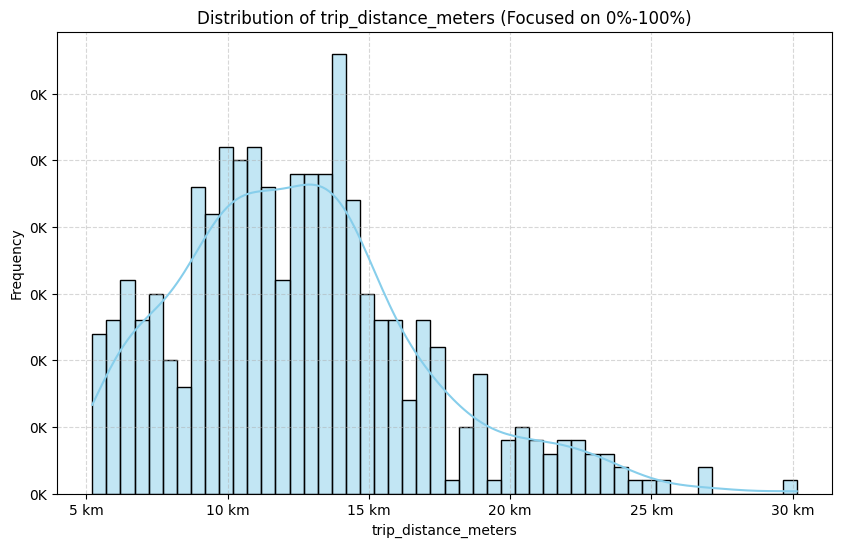

In [62]:
# plot_distribution(x_500, "trip_distance_meters", x_factor=1/60, x_unit="min", lower_quantile=0.0, upper_quantile=1, bins=50)
plot_distribution(x_500, "trip_distance_meters", x_factor=1/1000, x_unit="km", lower_quantile=0.0, upper_quantile=1, bins=50)

### no dist

In [99]:
def create_work_to_home_dataset(work_df, home_df, 
                               sample_size=1000,
                               min_distance=6000, 
                               max_distance=25000,
                               target_mean_distance=18170,
                               departure_date="2025-09-15",
                               departure_hour=17,  # 5 PM for work-to-home trips
                               max_time_spread_minutes=5,
                               max_attempts_per_work=50,
                               batch_size=50):
    """
    Create a dataset with work locations as pickup and home locations as dropoff,
    ensuring distance constraints and target average distance.
    
    Parameters:
    -----------
    work_df : DataFrame
        DataFrame containing work locations with 'latitude' and 'longitude' columns
    home_df : DataFrame  
        DataFrame containing home locations with 'latitude' and 'longitude' columns
    sample_size : int
        Number of work-to-home trips to generate
    min_distance : int
        Minimum distance in meters between work and home
    max_distance : int
        Maximum distance in meters between work and home
    target_mean_distance : int
        Target average distance in meters
    departure_date : str
        Date for all trips in format "YYYY-MM-DD"
    departure_hour : int
        Hour for departure (0-23)
    max_time_spread_minutes : int
        Maximum variation in departure minutes
    max_attempts_per_work : int
        Maximum attempts to find suitable home for each work location
    batch_size : int
        Batch size for distance calculations
    
    Returns:
    --------
    DataFrame with columns: pickup_latitude, pickup_longitude, dropoff_latitude, 
                           dropoff_longitude, start_time, end_time, trip_distance_meters, trip_seconds
    """
    
  
    
    print(f"Creating {sample_size} work-to-home trips...")
    print(f"Available work locations: {len(work_df)}")
    print(f"Available home locations: {len(home_df)}")
    print(f"Distance constraints: {min_distance}m - {max_distance}m")
    print(f"Target average distance: {target_mean_distance}m")
    
    # Convert input dataframes to ensure we have the right column names
    work_locations = work_df[['latitude', 'longitude']].copy()
    home_locations = home_df[['latitude', 'longitude']].copy()
    
    # Target date as datetime
    target_date = pd.to_datetime(departure_date)
    
    results = []
    attempts = 0
    max_total_attempts = sample_size * max_attempts_per_work
    
    # Keep track of distances for average calculation
    distances = []
    
    while len(results) < sample_size and attempts < max_total_attempts:
        batch_work_locations = []
        batch_home_locations = []
        batch_info = []
        
        # Prepare a batch
        for _ in range(min(batch_size, sample_size - len(results))):
            if attempts >= max_total_attempts:
                break
                
            # Randomly select work location
            work_idx = random.randint(0, len(work_locations) - 1)
            work_lat = work_locations.iloc[work_idx]['latitude']
            work_lon = work_locations.iloc[work_idx]['longitude']
            
            # Randomly select home location
            home_idx = random.randint(0, len(home_locations) - 1)
            home_lat = home_locations.iloc[home_idx]['latitude']
            home_lon = home_locations.iloc[home_idx]['longitude']
            
            batch_work_locations.append((work_lat, work_lon))
            batch_home_locations.append((home_lat, home_lon))
            batch_info.append({
                'work_lat': work_lat,
                'work_lon': work_lon,
                'home_lat': home_lat,
                'home_lon': home_lon,
                'attempt': attempts
            })
            
            attempts += 1
        
        if not batch_work_locations:
            break
            
        # Get distances for the batch
        try:
            # Create departure time for batch
            random_minutes = random.randint(0, max_time_spread_minutes)
            random_seconds = random.randint(0, 59)
            departure_time = target_date.replace(
                hour=departure_hour,
                minute=random_minutes,
                second=random_seconds
            )
            
            batch_results = get_batch_distances(
                batch_work_locations, 
                batch_home_locations, 
                departure_time
            )
            
            # Process batch results
            for i, (travel_time_seconds, distance_m) in enumerate([batch_results[i][i] for i in range(len(batch_results))]):
                if travel_time_seconds is not None and distance_m is not None:
                    # Check distance constraints
                    if min_distance <= distance_m <= max_distance:
                        info = batch_info[i]
                        
                        # Generate specific departure time for this trip
                        trip_random_minutes = random.randint(0, max_time_spread_minutes)
                        trip_random_seconds = random.randint(0, 59)
                        trip_departure_time = target_date.replace(
                            hour=departure_hour,
                            minute=trip_random_minutes,
                            second=trip_random_seconds
                        )
                        
                        trip_end_time = trip_departure_time + timedelta(seconds=travel_time_seconds)
                        
                        results.append({
                            'pickup_latitude': info['work_lat'],
                            'pickup_longitude': info['work_lon'],
                            'dropoff_latitude': info['home_lat'],
                            'dropoff_longitude': info['home_lon'],
                            'start_time': trip_departure_time,
                            'end_time': trip_end_time,
                            'trip_distance_meters': distance_m,
                            'trip_seconds': travel_time_seconds
                        })
                        
                        distances.append(distance_m)
                        
                        if len(results) >= sample_size:
                            break
                            
        except Exception as e:
            print(f"Error in batch processing: {e}")
            # Fall back to individual processing for this batch
            for info in batch_info:
                if len(results) >= sample_size:
                    break
                    
                try:
                    travel_time_seconds, distance_m = get_travel_time_and_distance(
                        info['work_lat'], info['work_lon'],
                        info['home_lat'], info['home_lon']
                    )
                    
                    if (travel_time_seconds is not None and distance_m is not None and 
                        min_distance <= distance_m <= max_distance):
                        
                        # Generate departure time
                        trip_random_minutes = random.randint(0, max_time_spread_minutes)
                        trip_random_seconds = random.randint(0, 59)
                        trip_departure_time = target_date.replace(
                            hour=departure_hour,
                            minute=trip_random_minutes,
                            second=trip_random_seconds
                        )
                        
                        trip_end_time = trip_departure_time + timedelta(seconds=travel_time_seconds)
                        
                        results.append({
                            'pickup_latitude': info['work_lat'],
                            'pickup_longitude': info['work_lon'],
                            'dropoff_latitude': info['home_lat'],
                            'dropoff_longitude': info['home_lon'],
                            'start_time': trip_departure_time,
                            'end_time': trip_end_time,
                            'trip_distance_meters': distance_m,
                            'trip_seconds': travel_time_seconds
                        })
                        
                        distances.append(distance_m)
                        
                except Exception as individual_error:
                    print(f"Error processing individual trip: {individual_error}")
                    continue
        
        # Progress update
        if len(results) % 50 == 0:
            current_avg = np.mean(distances) if distances else 0
            print(f"Progress: {len(results)}/{sample_size} trips created. "
                  f"Current avg distance: {current_avg:.0f}m (target: {target_mean_distance}m)")
    
    if len(results) == 0:
        raise ValueError("No valid work-to-home trips could be generated with the given constraints")
    
    # Create final DataFrame
    df_result = pd.DataFrame(results)
    
    # Print final statistics
    final_avg_distance = df_result['trip_distance_meters'].mean()
    print(f"\n📊 Final Dataset Statistics:")
    print(f"Generated trips: {len(df_result)}")
    print(f"Average distance: {final_avg_distance:.0f}m (target: {target_mean_distance}m)")
    print(f"Distance range: {df_result['trip_distance_meters'].min():.0f}m - {df_result['trip_distance_meters'].max():.0f}m")
    print(f"Average trip time: {df_result['trip_seconds'].mean()/60:.1f} minutes")
    print(f"Total attempts made: {attempts}")
    
    # Time spread verification
    start_times = pd.to_datetime(df_result['start_time'])
    time_spread_minutes = (start_times.max() - start_times.min()).total_seconds() / 60
    print(f"Actual time spread: {time_spread_minutes:.1f} minutes (target: ≤{max_time_spread_minutes} minutes)")
    
    return df_result

# Example usage:
# work_to_home_trips = create_work_to_home_dataset(
#     work_df=work_df_clean,
#     home_df=home_df_clean,
#     sample_size=500,
#     min_distance=6000,
#     max_distance=25000,
#     target_mean_distance=18170,
#     departure_date="2025-09-15",
#     departure_hour=17,  # 5 PM
#     max_time_spread_minutes=5
# )

## start sampling

### attempt 1 no dist

In [ ]:
sample_500 = create_work_to_home_dataset(work_df_clean, 
                                         home_df_clean,
                                         sample_size=500,
                                         min_distance=5000,
                                         max_distance=25000,
                                         target_mean_distance=18170,
                                         departure_date="2025-09-15",
                                         departure_hour=17, #5pm
                                         max_time_spread_minutes=5,
                                         max_attempts_per_work=50,
                                         batch_size=50
                                        )

Creating 500 work-to-home trips...
Available work locations: 431
Available home locations: 109220
Distance constraints: 5000m - 25000m
Target average distance: 18170m
Progress: 500/500 trips created. Current avg distance: 9701m (target: 18170m)

📊 Final Dataset Statistics:
Generated trips: 500
Average distance: 9701m (target: 18170m)
Distance range: 5041m - 23685m
Average trip time: 13.0 minutes
Total attempts made: 758
Actual time spread: 6.0 minutes (target: ≤5 minutes)


In [107]:
sample_500.head()

,pickup_latitude,pickup_longitude,dropoff_latitude,dropoff_longitude,start_time,end_time,trip_distance_meters,trip_seconds
0,31.214885,29.944864,31.225456,29.993993,2025-09-15 17:01:11,2025-09-15 17:13:31,7630.0,740
1,31.250517,29.975442,31.286598,30.029782,2025-09-15 17:00:38,2025-09-15 17:13:47,7410.0,789
2,31.207448,29.921769,31.217980,29.992423,2025-09-15 17:05:22,2025-09-15 17:18:36,9266.0,794
3,31.201357,29.906851,31.285197,30.039431,2025-09-15 17:01:41,2025-09-15 17:20:37,17129.0,1136
4,31.208548,29.913388,31.218288,29.988543,2025-09-15 17:01:35,2025-09-15 17:15:38,9349.0,843


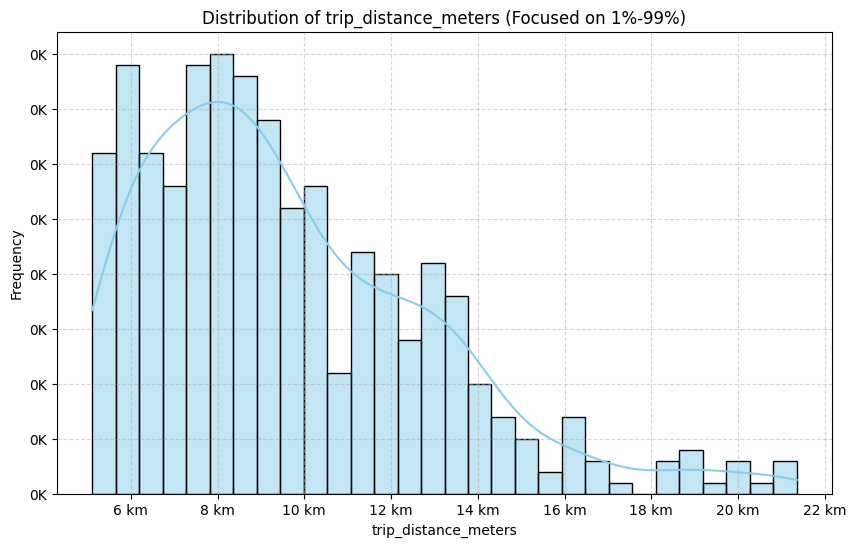

In [116]:
plot_distribution(sample_500,'trip_distance_meters',x_factor=1/1000,x_unit="km")

In [117]:
plot_on_map(sample_500,
           city_name="Work to Home Trips - Sample 500",
           sample_size=500,column_lat="pickup_latitude",column_lon="pickup_longitude")

In [118]:
plot_on_map(sample_500,
           city_name="Work to Home Trips - Sample 500",
           sample_size=500,column_lat="dropoff_latitude",column_lon="dropoff_longitude")

In [127]:
insert_into_database(sample_500,dataset_id="alex_500_18")

0.75
Creating 375 rider requests and 125 driver offers
2025-09-15T16:55:51+00:00 2025-09-15T17:16:25+00:00
Inserted 375 rider requests
Inserted 125 driver offers
Data import completed successfully


In [155]:
sample_1k = create_work_to_home_dataset(work_df_clean, 
                                         home_df_clean,
                                         sample_size=1000,
                                         min_distance=5000,
                                         max_distance=25000,
                                         target_mean_distance=18170,
                                         departure_date="2025-09-15",
                                         departure_hour=17, #5pm
                                         max_time_spread_minutes=5,
                                         max_attempts_per_work=50,
                                         batch_size=50
                                        )

Creating 1000 work-to-home trips...
Available work locations: 431
Available home locations: 109220
Distance constraints: 5000m - 25000m
Target average distance: 18170m
Progress: 800/1000 trips created. Current avg distance: 10354m (target: 18170m)
Progress: 1000/1000 trips created. Current avg distance: 10173m (target: 18170m)

📊 Final Dataset Statistics:
Generated trips: 1000
Average distance: 10173m (target: 18170m)
Distance range: 5017m - 24831m
Average trip time: 21.2 minutes
Total attempts made: 1487
Actual time spread: 6.0 minutes (target: ≤5 minutes)


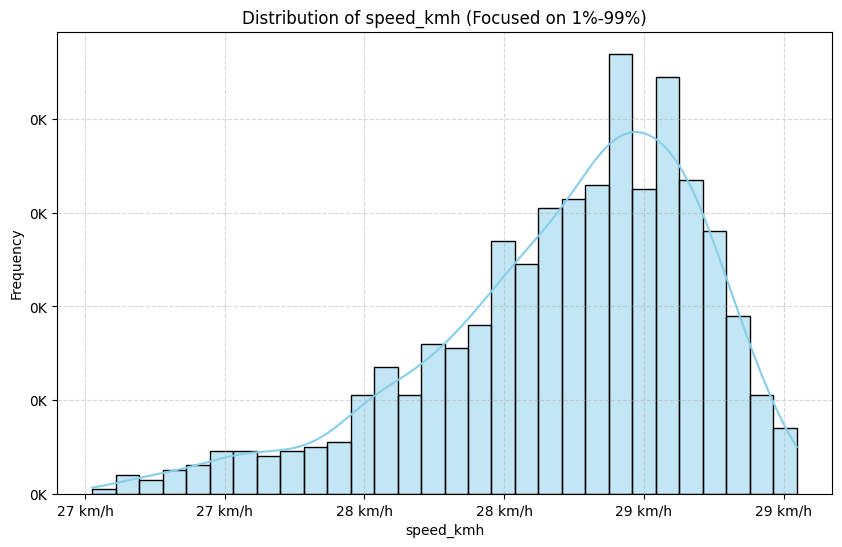

In [156]:
sample_1k['speed_kmh'] = (sample_1k['trip_distance_meters'] / sample_1k['trip_seconds']) * 3.6
plot_distribution(sample_1k, 'speed_kmh', x_factor=1, x_unit="km/h")

In [159]:
insert_into_database(sample_1k,dataset_id="alex_1k_fixed_30_0.7", rider_ratio=0.75)

0.75
Creating 750 rider requests and 250 driver offers
2025-09-15T16:53:33+00:00 2025-09-15T17:34:58+00:00
Inserted 750 rider requests
Inserted 250 driver offers
Data import completed successfully


In [158]:
insert_into_database(sample_1k,dataset_id="alex_1k_fixed_30", rider_ratio=0.65)

0.65
Creating 650 rider requests and 350 driver offers
2025-09-15T16:48:33+00:00 2025-09-15T17:34:58+00:00
Error: duplicate key value violates unique constraint "rider_requests_pkey"
DETAIL:  Key (id)=(dsalex_1k_fixed_30-req-000000) already exists.



In [149]:
sample_500_fixed = create_work_to_home_dataset(work_df_clean, 
                                         home_df_clean,
                                         sample_size=500,
                                         min_distance=5000,
                                         max_distance=25000,
                                         target_mean_distance=18170,
                                         departure_date="2025-09-15",
                                         departure_hour=17, #5pm
                                         max_time_spread_minutes=5,
                                         max_attempts_per_work=50,
                                         batch_size=50
                                        )

Creating 500 work-to-home trips...
Available work locations: 431
Available home locations: 109220
Distance constraints: 5000m - 25000m
Target average distance: 18170m
Progress: 500/500 trips created. Current avg distance: 10330m (target: 18170m)

📊 Final Dataset Statistics:
Generated trips: 500
Average distance: 10330m (target: 18170m)
Distance range: 5019m - 24918m
Average trip time: 21.5 minutes
Total attempts made: 770
Actual time spread: 6.0 minutes (target: ≤5 minutes)


In [150]:
sample_500_fixed.head()

,pickup_latitude,pickup_longitude,dropoff_latitude,dropoff_longitude,start_time,end_time,trip_distance_meters,trip_seconds
0,31.204033,29.905922,31.215903,29.963584,2025-09-15 17:05:34,2025-09-15 17:22:15,8058.0,1001
1,31.209897,29.919724,31.186613,29.906125,2025-09-15 17:05:16,2025-09-15 17:17:39,5389.0,743
2,31.193242,29.901517,31.270137,30.011431,2025-09-15 17:01:57,2025-09-15 17:33:22,15226.0,1885
3,31.207335,29.910599,31.257153,30.006161,2025-09-15 17:00:30,2025-09-15 17:25:45,12126.0,1515
4,31.229923,29.950225,31.271883,30.004581,2025-09-15 17:01:16,2025-09-15 17:17:30,7785.0,974


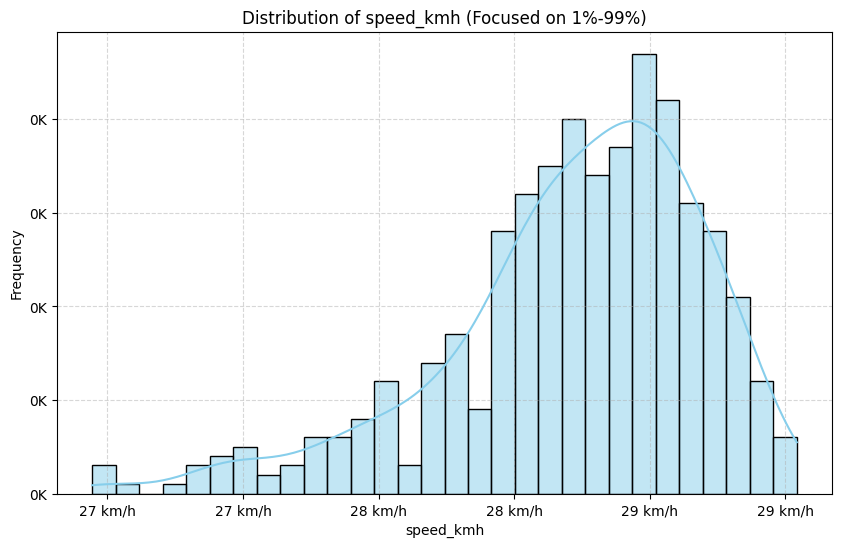

In [151]:
sample_500_fixed['speed_kmh'] = (sample_500_fixed['trip_distance_meters'] / sample_500_fixed['trip_seconds']) * 3.6
plot_distribution(sample_500_fixed, 'speed_kmh', x_factor=1, x_unit="km/h")

In [153]:
insert_into_database(sample_500_fixed,dataset_id="alex_500_fixed_18")      

0.75
Creating 375 rider requests and 125 driver offers
2025-09-15T16:55:34+00:00 2025-09-15T17:22:15+00:00
Inserted 375 rider requests
Inserted 125 driver offers
Data import completed successfully


In [ ]:
sample_1k

### attempt 2 gama agamy

In [117]:
attempt2=create_work_to_home_dataset_gamma(work_df=all_home_data,home_df=all_home_data,sample_size=1000,max_attempts_per_work=500)

Creating 1000 work-to-home trips with gamma distribution...
Target mean distance: 18170m (18.2km)
Gamma shape parameter: 2.0
Gamma scale parameter: 9085
Progress: 1000/1000 trips. Current avg: 16659m (target: 18170m)

📊 Final Dataset Statistics:
Generated trips: 1000
Average distance: 16659m (target: 18170m)
Standard deviation: 8434m
Distance range: 5037m - 34984m
Fitted gamma parameters: shape=3.89, scale=4.28
Fitted mean: 16.66km


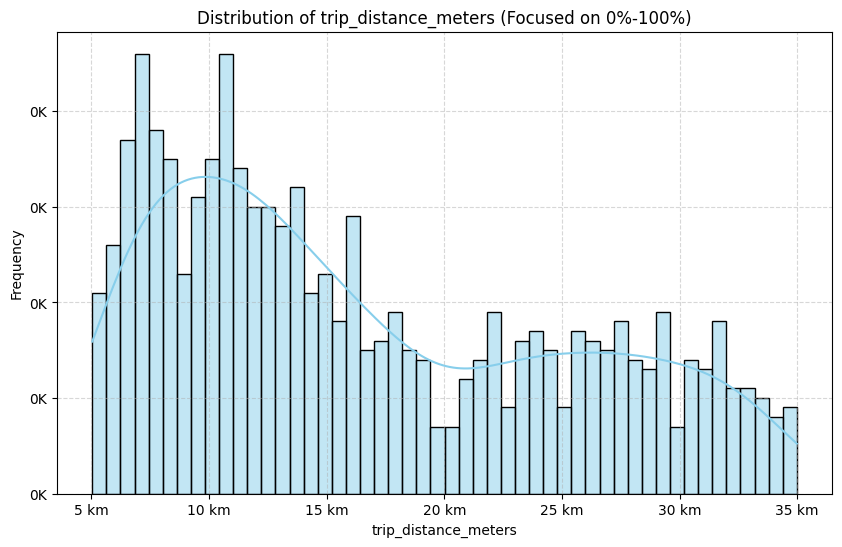

In [118]:
plot_distribution(attempt2, "trip_distance_meters", x_factor=1/1000, x_unit="km", lower_quantile=0.0, upper_quantile=1, bins=50)

In [131]:
attempt2.head()

,pickup_latitude,pickup_longitude,dropoff_latitude,dropoff_longitude,start_time,end_time,trip_distance_meters,trip_seconds,target_distance
0,31.187415,29.899092,31.202887,29.933276,2025-09-15 17:01:22,2025-09-15 17:14:39,6264.0,797,5000.000000
1,31.233685,29.974650,31.223910,29.935184,2025-09-15 17:00:04,2025-09-15 17:12:16,5627.0,732,5000.000000
2,31.230548,29.969867,31.087496,29.728959,2025-09-15 17:03:45,2025-09-15 18:10:04,32308.0,3979,35000.000000
3,31.102690,29.761429,31.223511,29.939284,2025-09-15 17:05:19,2025-09-15 17:54:41,23991.0,2962,21838.028596
4,31.200520,29.884208,31.086344,29.721694,2025-09-15 17:00:48,2025-09-15 17:48:56,23576.0,2888,35000.000000


In [119]:
insert_into_database(attempt2, dataset_id="alex_1k")

0.75
Creating 750 rider requests and 250 driver offers
2025-09-15T16:51:22+00:00 2025-09-15T17:14:39+00:00
Inserted 750 rider requests
Inserted 250 driver offers
Data import completed successfully


In [129]:
attempt2_osrm=add_osrm_data_batched(attempt2, batch_size=50)
attempt2_osrm.head()


Processing 1000 rows in batches of 50
Processing batch 1: rows 0 to 49
Processing batch 2: rows 50 to 99
Processing batch 3: rows 100 to 149
Processing batch 4: rows 150 to 199
Processing batch 5: rows 200 to 249
Processing batch 6: rows 250 to 299
Processing batch 7: rows 300 to 349
Processing batch 8: rows 350 to 399
Processing batch 9: rows 400 to 449
Processing batch 10: rows 450 to 499
Processing batch 11: rows 500 to 549
Processing batch 12: rows 550 to 599
Processing batch 13: rows 600 to 649
Processing batch 14: rows 650 to 699
Processing batch 15: rows 700 to 749
Processing batch 16: rows 750 to 799
Processing batch 17: rows 800 to 849
Processing batch 18: rows 850 to 899
Processing batch 19: rows 900 to 949
Processing batch 20: rows 950 to 999
Completed processing 1000 rows


,pickup_latitude,pickup_longitude,dropoff_latitude,dropoff_longitude,start_time,end_time,trip_distance_meters,trip_seconds,target_distance,osrm_distance_m,osrm_time_seconds
0,31.187415,29.899092,31.202887,29.933276,2025-09-15 17:01:22,2025-09-15 17:12:54.100,6264.0,797,5000.000000,4173.3,692.1
1,31.233685,29.974650,31.223910,29.935184,2025-09-15 17:00:04,2025-09-15 17:16:17.300,5627.0,732,5000.000000,7050.5,973.3
2,31.230548,29.969867,31.087496,29.728959,2025-09-15 17:03:45,2025-09-15 17:55:24.800,32308.0,3979,35000.000000,34951.4,3099.8
3,31.102690,29.761429,31.223511,29.939284,2025-09-15 17:05:19,2025-09-15 17:50:01.100,23991.0,2962,21838.028596,23893,2682.1
4,31.200520,29.884208,31.086344,29.721694,2025-09-15 17:00:48,2025-09-15 17:50:40.200,23576.0,2888,35000.000000,28959.8,2992.2


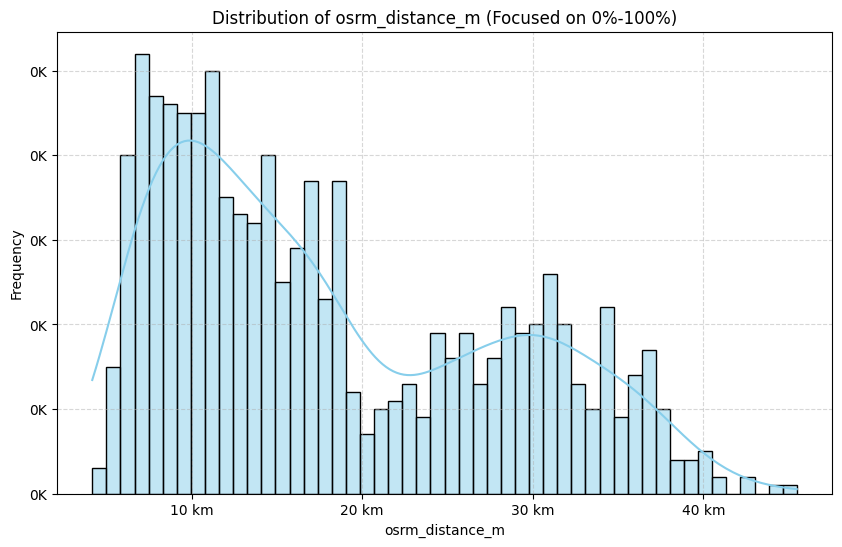

In [130]:
plot_distribution(attempt2_osrm, "osrm_distance_m", x_factor=1/1000, x_unit="km", lower_quantile=0.0, upper_quantile=1, bins=50)

In [132]:
insert_into_database(attempt2_osrm, dataset_id="alex_1k_osrm")

0.75
Creating 750 rider requests and 250 driver offers
2025-09-15T16:46:22+00:00 2025-09-15T17:12:54.100000+00:00
Inserted 750 rider requests
Inserted 250 driver offers
Data import completed successfully


In [ ]:
plot_distribution

In [184]:
orsm_sample=create_work_to_home_dataset_gamma_real_distance_osrm(work_df=all_work_data,
                                                                 home_df=all_home_data,
                                                                 sample_size=1000,
                                                                 max_attempts_per_work=500,
                                                                 gamma_shape=4)

Creating 1000 work-to-home trips with gamma distribution...
Target mean distance: 18170m (18.2km)
Gamma shape parameter: 4
Gamma scale parameter: 4542
Progress: 1000/1000 trips. Current avg: 13470m (target: 18170m)

📊 Final Dataset Statistics:
Generated trips: 1000
Average distance: 13470m (target: 18170m)
Standard deviation: 7595m
Distance range: 5002m - 34502m
Target distance avg: 17816m
Actual distance avg: 13470m
Target vs Actual correlation: 0.042
Fitted gamma parameters: shape=3.68, scale=3.67
Fitted mean: 13.47km


In [187]:
orsm_sample =add_osrm_data_batched(orsm_sample,batch_size=50)
print(orsm_sample["osrm_distance_m"].mean())
orsm_sample["trip_distance_meters"].mean()


Processing 1000 rows in batches of 50
Processing batch 1: rows 0 to 49
Processing batch 2: rows 50 to 99
Processing batch 3: rows 100 to 149
Processing batch 4: rows 150 to 199
Processing batch 5: rows 200 to 249
Processing batch 6: rows 250 to 299
Processing batch 7: rows 300 to 349
Processing batch 8: rows 350 to 399
Processing batch 9: rows 400 to 449
Processing batch 10: rows 450 to 499
Processing batch 11: rows 500 to 549
Processing batch 12: rows 550 to 599
Processing batch 13: rows 600 to 649
Processing batch 14: rows 650 to 699
Processing batch 15: rows 700 to 749
Processing batch 16: rows 750 to 799
Processing batch 17: rows 800 to 849
Processing batch 18: rows 850 to 899
Processing batch 19: rows 900 to 949
Processing batch 20: rows 950 to 999
Completed processing 1000 rows
13470.2234


13470.223399999999

In [ ]:
orsm_sample =add_valhalla_data_batched(orsm_sample,batch_size=50)
orsm_sample["valhalla_distance_m"].mean()


Processing 100 rows in batches of 50
Processing batch 1: rows 0 to 49
Processing batch 2: rows 50 to 99
Completed processing 100 rows


11696.87

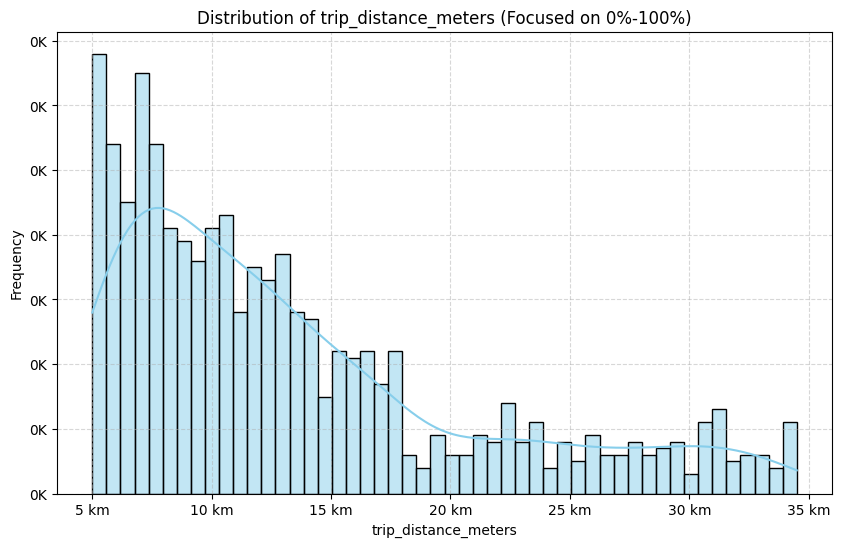

In [185]:
plot_distribution(orsm_sample, "trip_distance_meters", x_factor=1/1000, x_unit="km", lower_quantile=0.0, upper_quantile=1, bins=50)

Average speed: 36.37 km/h


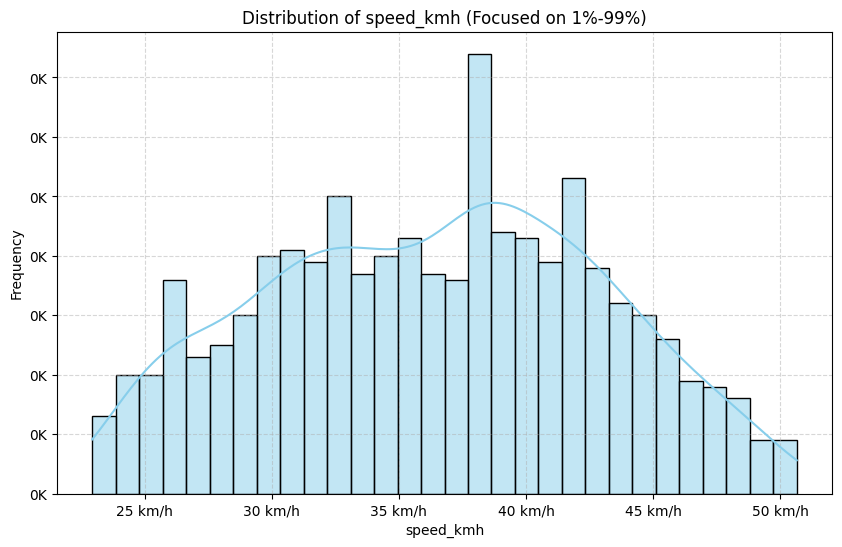

In [186]:
speed= (orsm_sample['trip_distance_meters'] / orsm_sample['trip_seconds']) * 3.6
orsm_sample['speed_kmh'] = speed
print(f"Average speed: {orsm_sample['speed_kmh'].mean():.2f} km/h")
plot_distribution(orsm_sample, 'speed_kmh', x_factor=1, x_unit="km/h")

In [190]:
orsm_sample.head()

,pickup_latitude,pickup_longitude,dropoff_latitude,dropoff_longitude,start_time,end_time,trip_distance_meters,trip_seconds,target_distance,speed_kmh,osrm_distance_m,osrm_time_seconds
0,31.212334,29.884341,31.196132,29.927106,2025-09-15 17:02:10,2025-09-15 17:16:14.100,7207.8,844.1,11319.013157,30.740528,7207.8,844.1
1,31.220938,29.933842,31.267227,30.007409,2025-09-15 17:05:24,2025-09-15 17:20:22.000,10749.4,898.0,13580.456250,43.093363,10749.4,898
2,31.196904,29.897967,31.230496,29.967994,2025-09-15 17:05:01,2025-09-15 17:24:03.600,10408.9,1142.6,10812.192266,32.795414,10408.9,1142.6
3,31.213987,29.919972,31.258183,30.020250,2025-09-15 17:01:49,2025-09-15 17:19:52.600,14374.9,1083.6,21740.301925,47.757143,14374.9,1083.6
4,31.215837,29.941974,31.267363,30.015903,2025-09-15 17:04:15,2025-09-15 17:26:30.800,11919.5,1335.8,13489.395389,32.123222,11919.5,1335.8


In [145]:
orsm_sample=create_work_to_home_dataset_gamma_osrm(work_df=all_work_data,home_df=all_home_data,sample_size=100,max_attempts_per_work=100)

Creating 100 work-to-home trips with gamma distribution...
Target mean distance: 18170m (18.2km)
Gamma shape parameter: 2.0
Gamma scale parameter: 9085
Progress: 100/100 trips. Current avg: 17830m (target: 18170m)

📊 Final Dataset Statistics:
Generated trips: 100
Average distance: 17830m (target: 18170m)
Standard deviation: 8340m
Distance range: 5624m - 34503m
Fitted gamma parameters: shape=4.34, scale=4.11
Fitted mean: 17.83km


In [189]:
insert_into_database(orsm_sample, dataset_id="alex_1k_osrm_ss")

0.75
Creating 750 rider requests and 250 driver offers
2025-09-15T16:52:10+00:00 2025-09-15T17:16:14.100000+00:00
Inserted 750 rider requests
Inserted 250 driver offers
Data import completed successfully


In [30]:
osrm_5k = create_work_to_home_dataset_gamma_real_distance_osrm(work_df=all_work_data,
                                                                 home_df=all_home_data,
                                                                 sample_size=5000,
                                                                 max_time_spread_minutes=10,
                                                                 max_attempts_per_work=500,
                                                                 gamma_shape=4)

NameError: name 'all_work_data' is not defined

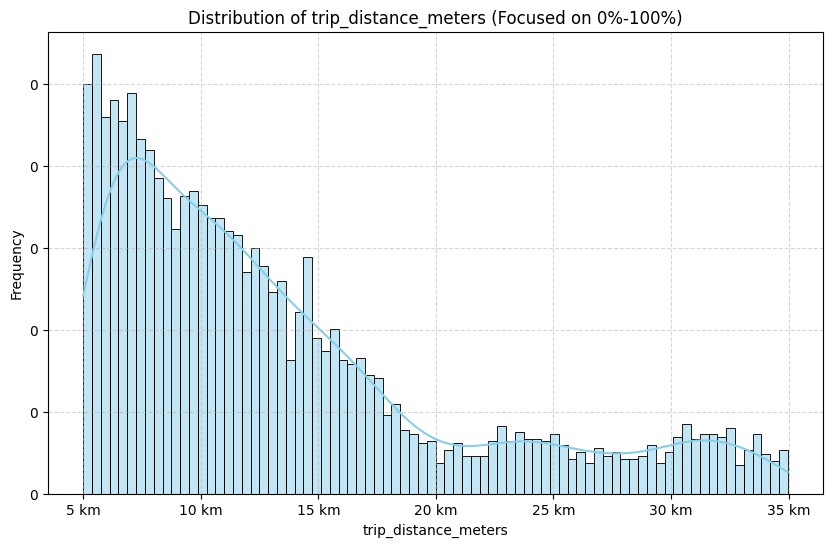

In [111]:
plot_distribution(osrm_5k, "trip_distance_meters", x_factor=1/1000, x_unit="km", lower_quantile=0.0, upper_quantile=1, bins=80)

In [112]:
insert_into_database(osrm_5k, dataset_id="alex_5k_osrm_last")

0.75
Creating 3750 rider requests and 1250 driver offers
2025-09-15T16:54:28+00:00 2025-09-15T17:21:06.900000+00:00
Inserted 1000 rider requests
2025-09-15T16:52:52+00:00 2025-09-15T17:23:00.200000+00:00
Inserted 1000 rider requests
2025-09-15T16:56:46+00:00 2025-09-15T17:27:19.400000+00:00
Inserted 1000 rider requests
2025-09-15T16:40:55+00:00 2025-09-15T17:21:47.400000+00:00
Inserted 750 rider requests
Inserted 1000 driver offers
Inserted 250 driver offers
Data import completed successfully


In [72]:
osrm_2k = create_work_to_home_dataset_gamma_real_distance_osrm(work_df=all_work_data,
                                                                 home_df=all_home_data,
                                                                 sample_size=2000,
                                                                 max_time_spread_minutes=10,
                                                                 max_attempts_per_work=500,
                                                                 gamma_shape=4)

Creating 2000 work-to-home trips with gamma distribution...
Target mean distance: 18170m (18.2km)
Gamma shape parameter: 4
Gamma scale parameter: 4542
Progress: 250/2000 trips. Current avg: 12765m (target: 18170m)
Progress: 2000/2000 trips. Current avg: 13336m (target: 18170m)

📊 Final Dataset Statistics:
Generated trips: 2000
Average distance: 13336m (target: 18170m)
Standard deviation: 7362m
Distance range: 5002m - 34936m
Target distance avg: 17820m
Actual distance avg: 13336m
Target vs Actual correlation: -0.013
Fitted gamma parameters: shape=3.90, scale=3.42
Fitted mean: 13.34km


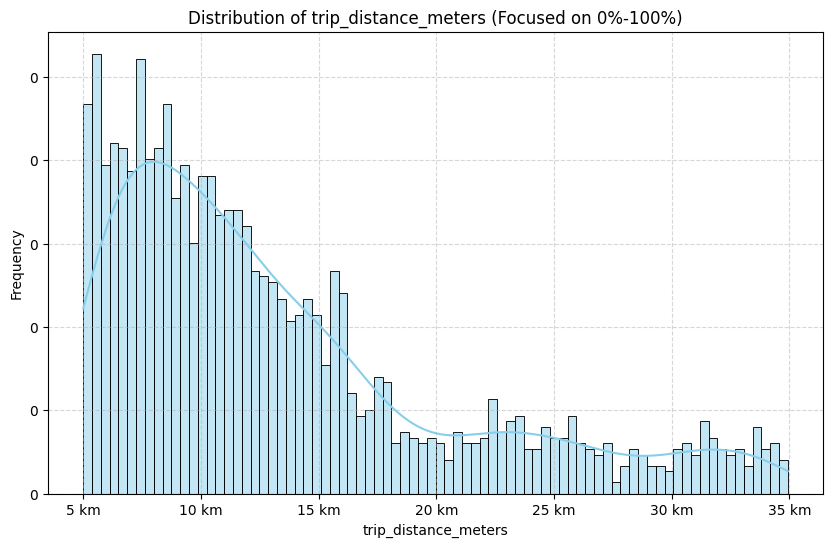

In [73]:
plot_distribution(osrm_2k, "trip_distance_meters", x_factor=1/1000, x_unit="km", lower_quantile=0.0, upper_quantile=1, bins=80)

In [74]:
insert_into_database(osrm_2k, dataset_id="alex_2k_osrm_last")

0.75
Creating 1500 rider requests and 500 driver offers
2025-09-15T16:50:19+00:00 2025-09-15T17:25:29.600000+00:00
Inserted 1000 rider requests
2025-09-15T16:47:32+00:00 2025-09-15T17:23:36.700000+00:00
Inserted 500 rider requests
Inserted 500 driver offers
Data import completed successfully


In [119]:
osrm_5k.to_csv("alex/all_alex/alex_5k_osrm_last.csv")

In [75]:
osrm_1k = create_work_to_home_dataset_gamma_real_distance_osrm(work_df=all_work_data,
                                                                 home_df=all_home_data,
                                                                 sample_size=1000,
                                                                 max_time_spread_minutes=5,
                                                                 max_attempts_per_work=500,
                                                                 gamma_shape=4)

Creating 1000 work-to-home trips with gamma distribution...
Target mean distance: 18170m (18.2km)
Gamma shape parameter: 4
Gamma scale parameter: 4542


Progress: 650/1000 trips. Current avg: 13263m (target: 18170m)
Progress: 1000/1000 trips. Current avg: 13455m (target: 18170m)

📊 Final Dataset Statistics:
Generated trips: 1000
Average distance: 13455m (target: 18170m)
Standard deviation: 7727m
Distance range: 5034m - 34835m
Target distance avg: 17835m
Actual distance avg: 13455m
Target vs Actual correlation: 0.043
Fitted gamma parameters: shape=3.57, scale=3.77
Fitted mean: 13.46km


In [76]:
insert_into_database(osrm_1k, dataset_id="alex_1k_osrm_last")

0.75
Creating 750 rider requests and 250 driver offers
2025-09-15T16:52:08+00:00 2025-09-15T17:20:25.400000+00:00
Inserted 750 rider requests
Inserted 250 driver offers
Data import completed successfully


In [115]:
osrm_1k.to_csv("alex/all_alex/alex_1k_osrm_last.csv")

In [77]:
osrm_500 = create_work_to_home_dataset_gamma_real_distance_osrm(work_df=all_work_data,
                                                                 home_df=all_home_data,
                                                                 sample_size=500,
                                                                 max_time_spread_minutes=3,
                                                                 max_attempts_per_work=500,
                                                                 gamma_shape=4)

Creating 500 work-to-home trips with gamma distribution...
Target mean distance: 18170m (18.2km)
Gamma shape parameter: 4
Gamma scale parameter: 4542
Progress: 500/500 trips. Current avg: 13132m (target: 18170m)

📊 Final Dataset Statistics:
Generated trips: 500
Average distance: 13132m (target: 18170m)
Standard deviation: 7534m
Distance range: 5046m - 34926m
Target distance avg: 17225m
Actual distance avg: 13132m
Target vs Actual correlation: 0.045
Fitted gamma parameters: shape=3.71, scale=3.54
Fitted mean: 13.13km


In [ ]:
insert_into_database(osrm_500, dataset_id="alex_500_osrm_last")

0.75
Creating 375 rider requests and 125 driver offers
2025-09-15T16:53:56+00:00 2025-09-15T17:21:00.800000+00:00
Inserted 375 rider requests
Inserted 125 driver offers
Data import completed successfully


In [ ]:
osrm_500.to_csv("alex/all_alex/alex_500_osrm_last.csv")

In [107]:
osrm_1k_smaller = create_work_to_home_dataset_gamma_real_distance_osrm(work_df=work_df_clean,
                                                                 home_df=home_df_clean,
                                                                 sample_size=1000,
                                                                 max_time_spread_minutes=5,
                                                                 max_attempts_per_work=500,
                                                                 gamma_shape=4)

Creating 1000 work-to-home trips with gamma distribution...
Target mean distance: 18170m (18.2km)
Gamma shape parameter: 4
Gamma scale parameter: 4542
Progress: 750/1000 trips. Current avg: 10836m (target: 18170m)
Progress: 1000/1000 trips. Current avg: 10781m (target: 18170m)

📊 Final Dataset Statistics:
Generated trips: 1000
Average distance: 10781m (target: 18170m)
Standard deviation: 4410m
Distance range: 5003m - 25906m
Target distance avg: 17888m
Actual distance avg: 10781m
Target vs Actual correlation: -0.023
Fitted gamma parameters: shape=6.51, scale=1.66
Fitted mean: 10.78km


In [108]:
insert_into_database(osrm_1k_smaller, dataset_id="alex_1k_cleaner")

0.75
Creating 750 rider requests and 250 driver offers
2025-09-15T16:47:41+00:00 2025-09-15T17:23:17.700000+00:00
Inserted 750 rider requests
Inserted 250 driver offers
Data import completed successfully


In [ ]:
osrm_500.to_csv("alex/all_alex/alex_1k_osrm_last.csv")

In [120]:
osrm_1k_smaller.to_csv("alex/smaller_area/alex_1k_cleaner.csv")

In [124]:
all_work_data.to_csv("all_work.csv", index=False)

In [39]:
home_df_clean = pd.read_csv("alex/home_df_clean.csv")
work_df_clean = pd.read_csv("alex/work_df_clean.csv")

C:\Users\mariam\AppData\Local\Temp\ipykernel_18524\727282154.py:1: DtypeWarning: Columns (1,3,5,6,8,9,10,11,12,15,16,17,18,21,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,118,119,120,121,122,123,124,126,127,128,129,132,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,159,160,161,163,164,165,166,167,168,169,170,171,172,173,176,177,178,179,180,181,182,183,184,185,186,187,188,189,191,192,193,194,195,201,202) have mixed types. Specify dtype option on import or set low_memory=False.
  home_df_clean = pd.read_csv("alex/home_df_clean.csv")


In [25]:
work_df_clean.head()

,geometry,addr:street,amenity,name,name:ar,name:en,addr:city,office,operator,emergency,...,architect,building:architecture,start_date,alt_name:en,smoking,grades,type,landuse,latitude,longitude
0,POINT (29.9116057 31.206813),NaN,bank,البنك الأهلي المصري,البنك الأهلي المصري,National Bank Of Egypt,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,31.206813,29.911606
1,POINT (29.9214767 31.1997261),شارع الشهيد جلال الدين الدسوقي,school,مدرسة أم الرب,مدرسة أم الرب,Collège de la mère de Dieu,الاسكندرية,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,31.199726,29.921477
2,POINT (29.9067552 31.1892701),NaN,school,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,31.189270,29.906755
3,POINT (29.9137596 31.1923271),NaN,school,مدرسة العباسية الثانوية,مدرسة العباسية الثانوية,Al-Abbassia Secondary School,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,31.192327,29.913760
4,POINT (29.9982302 31.2654734),NaN,university,الأكاديمية العربية للعلوم والتكنولوجيا والنقل ...,الأكاديمية العربية للعلوم والتكنولوجيا والنقل ...,"The Arab Academy for Science, Technology and M...",NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,31.265473,29.998230


## clean

In [26]:
osrm_500k_smaller = create_work_to_home_dataset_gamma_real_distance_osrm(work_df=work_df_clean,
                                                                 home_df=home_df_clean,
                                                                 sample_size=500,
                                                                 max_time_spread_minutes=5,
                                                                 max_attempts_per_work=500,
                                                                 gamma_shape=4)

Creating 500 work-to-home trips with gamma distribution...
Target mean distance: 18170m (18.2km)
Gamma shape parameter: 4
Gamma scale parameter: 4542
Progress: 400/500 trips. Current avg: 10565m (target: 18170m)
Progress: 500/500 trips. Current avg: 10669m (target: 18170m)

📊 Final Dataset Statistics:
Generated trips: 500
Average distance: 10669m (target: 18170m)
Standard deviation: 4407m
Distance range: 5011m - 26127m
Target distance avg: 17774m
Actual distance avg: 10669m
Target vs Actual correlation: 0.028
Fitted gamma parameters: shape=6.30, scale=1.69
Fitted mean: 10.67km


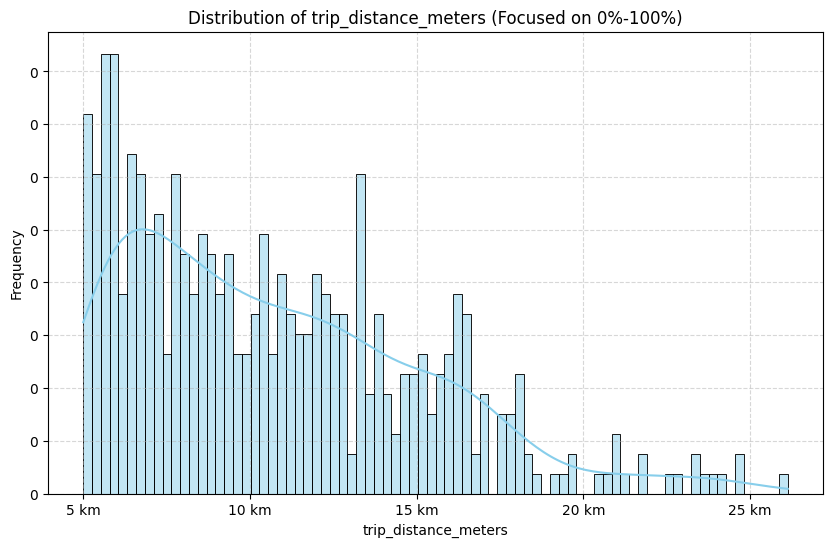

In [28]:
plot_distribution(osrm_500k_smaller, "trip_distance_meters", x_factor=1/1000, x_unit="km", lower_quantile=0.0, upper_quantile=1, bins=80)

In [29]:
insert_into_database(osrm_500k_smaller, dataset_id="alex_500_osrm_cleaner")

0.75
Creating 375 rider requests and 125 driver offers
2025-09-15T16:43:10+00:00 2025-09-15T17:15:42.700000+00:00
Inserted 375 rider requests
Inserted 125 driver offers
Data import completed successfully


In [40]:
osrm_2k_smaller = create_work_to_home_dataset_gamma_real_distance_osrm(work_df=work_df_clean,
                                                                 home_df=home_df_clean,
                                                                 sample_size=2000,
                                                                 max_time_spread_minutes=10,
                                                                 max_attempts_per_work=500,
                                                                 gamma_shape=4)

Creating 2000 work-to-home trips with gamma distribution...
Target mean distance: 18170m (18.2km)
Gamma shape parameter: 4
Gamma scale parameter: 4542
Progress: 2000/2000 trips. Current avg: 10618m (target: 18170m)

📊 Final Dataset Statistics:
Generated trips: 2000
Average distance: 10618m (target: 18170m)
Standard deviation: 4272m
Distance range: 5002m - 27411m
Target distance avg: 17696m
Actual distance avg: 10618m
Target vs Actual correlation: 0.005
Fitted gamma parameters: shape=6.73, scale=1.58
Fitted mean: 10.62km


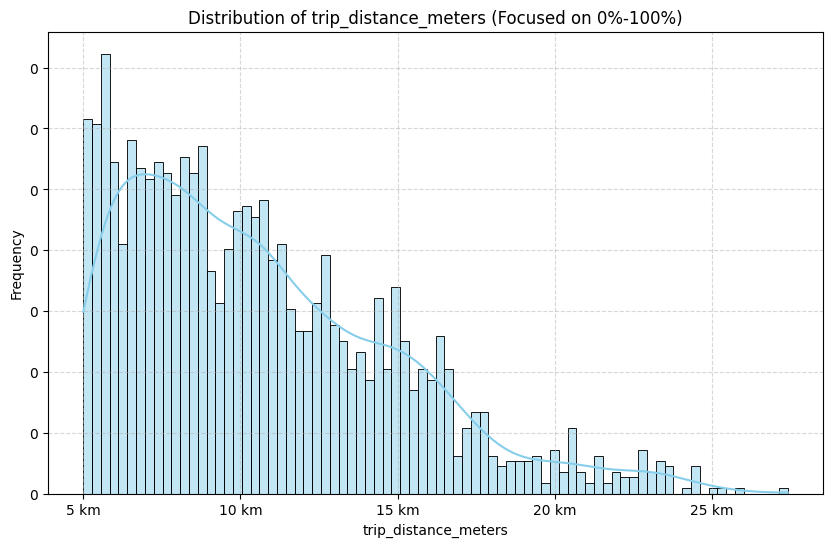

In [56]:
plot_distribution(osrm_2k_smaller, "trip_distance_meters", x_factor=1/1000, x_unit="km", lower_quantile=0.0, upper_quantile=1, bins=80)

In [65]:
osrm_3k_smaller = create_work_to_home_dataset_gamma_real_distance_osrm(work_df=work_df_clean,
                                                                 home_df=home_df_clean,
                                                                 sample_size=3000,
                                                                 max_time_spread_minutes=10,
                                                                 max_attempts_per_work=500,
                                                                 gamma_shape=4)

Creating 3000 work-to-home trips with gamma distribution...
Target mean distance: 18170m (18.2km)
Gamma shape parameter: 4
Gamma scale parameter: 4542
Progress: 2100/3000 trips. Current avg: 10578m (target: 18170m)
Progress: 3000/3000 trips. Current avg: 10639m (target: 18170m)

📊 Final Dataset Statistics:
Generated trips: 3000
Average distance: 10639m (target: 18170m)
Standard deviation: 4297m
Distance range: 5000m - 26075m
Target distance avg: 18105m
Actual distance avg: 10639m
Target vs Actual correlation: -0.018
Fitted gamma parameters: shape=6.73, scale=1.58
Fitted mean: 10.64km


In [66]:
insert_into_database(osrm_3k_smaller, dataset_id="alex_3k_osrm_cleaner_0.75_multi",rider_ratio=0.75)

0.75
Creating 2250 rider requests and 750 driver offers
2025-09-15T16:54:02+00:00 2025-09-15T17:24:37.800000+00:00
Inserted 1000 rider requests
2025-09-15T16:58:08+00:00 2025-09-15T17:25:04.700000+00:00
Inserted 1000 rider requests
2025-09-15T17:00:06+00:00 2025-09-15T17:27:11.500000+00:00
Inserted 250 rider requests
Inserted 750 driver offers
Data import completed successfully


In [60]:
insert_into_database(osrm_2k_smaller, dataset_id="alex_2k_osrm_cleaner_0.25_multi",rider_ratio=0.25)

0.25
Creating 500 rider requests and 1500 driver offers
2025-09-15T16:54:37+00:00 2025-09-15T17:25:12.200000+00:00
Inserted 500 rider requests
Inserted 1000 driver offers
Inserted 500 driver offers
Data import completed successfully


In [31]:
osrm_5k_smaller = create_work_to_home_dataset_gamma_real_distance_osrm(work_df=work_df_clean,
                                                                 home_df=home_df_clean,
                                                                 sample_size=5000,
                                                                 max_time_spread_minutes=10,
                                                                 max_attempts_per_work=500,
                                                                 gamma_shape=4)

Creating 5000 work-to-home trips with gamma distribution...
Target mean distance: 18170m (18.2km)
Gamma shape parameter: 4
Gamma scale parameter: 4542
Progress: 1800/5000 trips. Current avg: 10667m (target: 18170m)
Progress: 1900/5000 trips. Current avg: 10646m (target: 18170m)
Progress: 2900/5000 trips. Current avg: 10697m (target: 18170m)
Progress: 4350/5000 trips. Current avg: 10779m (target: 18170m)
Progress: 4900/5000 trips. Current avg: 10772m (target: 18170m)
Progress: 5000/5000 trips. Current avg: 10773m (target: 18170m)

📊 Final Dataset Statistics:
Generated trips: 5000
Average distance: 10773m (target: 18170m)
Standard deviation: 4218m
Distance range: 5000m - 26402m
Target distance avg: 17941m
Actual distance avg: 10773m
Target vs Actual correlation: 0.006
Fitted gamma parameters: shape=6.93, scale=1.56
Fitted mean: 10.77km


In [32]:
osrm_5k_smaller.head(10)

,pickup_latitude,pickup_longitude,dropoff_latitude,dropoff_longitude,start_time,end_time,trip_distance_meters,trip_seconds,target_distance
0,31.210084,29.913649,31.204980,29.883016,2025-09-15 17:07:54,2025-09-15 17:15:09.000,5006.3,435.0,13862.676326
1,31.262571,29.997118,31.201823,29.880730,2025-09-15 17:08:28,2025-09-15 17:29:24.700,14827.7,1256.7,5000.000000
2,31.204220,29.907710,31.231509,29.983501,2025-09-15 17:01:00,2025-09-15 17:19:17.900,11858.4,1097.9,10955.333447
3,31.206453,29.882515,31.246793,29.974696,2025-09-15 17:02:37,2025-09-15 17:17:12.000,11684.0,875.0,12495.478533
4,31.198960,29.908765,31.240538,29.983501,2025-09-15 17:03:17,2025-09-15 17:21:19.400,11675.3,1082.4,18803.945547
5,31.223534,29.938801,31.247157,30.014261,2025-09-15 17:08:22,2025-09-15 17:27:59.000,9675.3,1177.0,17616.435204
6,31.197848,29.894978,31.245746,30.014789,2025-09-15 17:05:50,2025-09-15 17:31:46.700,15066.7,1556.7,20986.425002
7,31.195217,29.912587,31.319361,30.058002,2025-09-15 17:02:42,2025-09-15 17:34:50.800,23768.4,1928.8,8125.195493
8,31.240329,29.997115,31.189731,29.891991,2025-09-15 17:09:16,2025-09-15 17:36:50.000,17454.7,1654.0,19629.375069
9,31.256825,29.978792,31.294233,30.055013,2025-09-15 17:00:58,2025-09-15 17:13:11.500,10082.4,733.5,19091.476676


In [35]:
save_to_csv(osrm_5k_smaller, dataset_id="alex_5k_osrm")

Rider ratio: 0.75
Creating 3750 rider requests and 1250 driver offers
Processed 1000 rider requests
Processed 1000 rider requests
Processed 1000 rider requests
Processed 750 rider requests
Processed 1000 driver offers
Processed 250 driver offers
✅ Saved 3750 rider requests to: alex_5k_osrm_rider_requests.csv
✅ Saved 1250 driver offers to: alex_5k_osrm_driver_offers.csv
Data export completed successfully


(                             id                   user_id  source_latitude  \
 0     dsalex_5k_osrm-req-000000  dsalex_5k_osrm-user-3147        31.210084   
 1     dsalex_5k_osrm-req-000001  dsalex_5k_osrm-user-5374        31.262571   
 2     dsalex_5k_osrm-req-000002  dsalex_5k_osrm-user-4974        31.204220   
 3     dsalex_5k_osrm-req-000003  dsalex_5k_osrm-user-1695        31.206453   
 4     dsalex_5k_osrm-req-000004  dsalex_5k_osrm-user-9719        31.198960   
 ...                         ...                       ...              ...   
 3745  dsalex_5k_osrm-req-006745  dsalex_5k_osrm-user-6108        31.194988   
 3746  dsalex_5k_osrm-req-006746  dsalex_5k_osrm-user-4878        31.198952   
 3747  dsalex_5k_osrm-req-006747  dsalex_5k_osrm-user-7092        31.211891   
 3748  dsalex_5k_osrm-req-006748  dsalex_5k_osrm-user-5194        31.275096   
 3749  dsalex_5k_osrm-req-006749  dsalex_5k_osrm-user-7171        31.219789   
 
       source_longitude source_address  destinatio

In [34]:
insert_into_database(osrm_5k_smaller, dataset_id="alex_5k_osrm_cleaner")

0.75
Creating 3750 rider requests and 1250 driver offers
2025-09-15T16:53:04+00:00 2025-09-15T17:21:09.500000+00:00
Inserted 1000 rider requests
2025-09-15T16:49:22+00:00 2025-09-15T17:10:43.400000+00:00
Inserted 1000 rider requests
2025-09-15T16:49:11+00:00 2025-09-15T17:27:46.300000+00:00
Inserted 1000 rider requests
2025-09-15T16:55:30+00:00 2025-09-15T17:38:01.400000+00:00
Inserted 750 rider requests
Inserted 1000 driver offers
Inserted 250 driver offers
Data import completed successfully


In [23]:
osrm_1k_smaller = pd.read_csv("alex/smaller_area/alex_1k_cleaner.csv")

In [24]:
datetime_columns = ['start_time', 'end_time']   
for col in datetime_columns:
    if not pd.api.types.is_datetime64_any_dtype(osrm_1k_smaller[col]):
        osrm_1k_smaller[col] = pd.to_datetime(osrm_1k_smaller[col])

In [12]:
len(osrm_1k_smaller)

1000

In [36]:
insert_into_database(osrm_1k_smaller, dataset_id="alex_1k_osrm_cleaner_0.5", rider_ratio=0.5)

0.5
Creating 500 rider requests and 500 driver offers
2025-09-15T16:47:41+00:00 2025-09-15T17:23:17.700000+00:00
Inserted 500 rider requests
Inserted 500 driver offers
Data import completed successfully


## variation

In [33]:
insert_into_database(osrm_1k_smaller, dataset_id="alex_1k_osrm_cleaner_1passenger")

0.75
Creating 750 rider requests and 250 driver offers
2025-09-15T16:52:41+00:00 2025-09-15T17:23:17.700000+00:00
Inserted 750 rider requests
Inserted 250 driver offers
Data import completed successfully


In [ ]:
insert_into_database(osrm_2k_smaller, dataset_id="alex_2k_osrm_cleaner_0.25_multi",rider_ratio=0.25)

In [87]:
RIDER_DETOUR_VALUES = [0, 10, 15, 20, 25]
RIDER_DETOUR_WEIGHTS = [0.0425, 0.4434, 0.3302, 0.1085, 0.0755]
#walking time
WALKING_DURATION_VALUES = [0, 5, 10, 15, 20,]  
WALKING_DURATION_WEIGHTS = [0.0095, 0.4571, 0.3571, 0.0905, 0.0085]
#passenger per request
RIDERS_PER_REQUEST_VALUES = [1, 2, 3]
RIDERS_PER_REQUEST_WEIGHTS = [0.6509, 0.2925, 0.0566]

# Driver detour
DRIVER_DETOUR_VALUES = [0, 10, 15, 20, 25]
DRIVER_DETOUR_WEIGHTS = [0.2745, 0.4314, 0.1765, 0.0784, 0.0392]

# car capacity
DRIVER_CAPACITY_VALUES = [1, 2, 3]
DRIVER_CAPACITY_WEIGHTS = [0.0847, 0.2542, 0.661]

# Gender preferences
FEMALE_SAME_GENDER_WEIGHTS = [0.7703, 0.2297]  # [True, False]
MALE_SAME_GENDER_WEIGHTS = [0.6159, 0.3841]    # [True, False]

# male to female dirver ratio
DRIVER_GENDER_WEIGHTS = [0.6471, 0.3529]      # [male, female]
# male to female rider ratio
RIDER_GENDER_WEIGHTS = [0.6522, 0.3478]       # [male, female]


In [67]:
# Flexible riders - willing to accept longer detours
RIDER_DETOUR_VALUES = [0, 10, 15, 20, 25]
RIDER_DETOUR_WEIGHTS = [0.03, 0.04, 0.08, 0.15, 0.70]

In [68]:
insert_into_database(osrm_2k_smaller, dataset_id= "alex_2k_osrm_cleaner_high_detour_r")

0.75
Creating 1500 rider requests and 500 driver offers
2025-09-15T16:39:37+00:00 2025-09-15T17:25:12.200000+00:00
Inserted 1000 rider requests
2025-09-15T16:41:35+00:00 2025-09-15T17:15:06.300000+00:00
Inserted 500 rider requests
Inserted 500 driver offers
Data import completed successfully


In [69]:
# Many riders want direct routes only
RIDER_DETOUR_VALUES = [0, 10, 15, 20, 25]
RIDER_DETOUR_WEIGHTS = [0.70, 0.15, 0.08, 0.04, 0.03]

In [70]:
insert_into_database(osrm_2k_smaller, dataset_id= "alex_2k_osrm_cleaner_low_detour_r")

0.75
Creating 1500 rider requests and 500 driver offers
2025-09-15T17:04:37+00:00 2025-09-15T17:25:12.200000+00:00
Inserted 1000 rider requests
2025-09-15T17:01:35+00:00 2025-09-15T17:15:06.300000+00:00
Inserted 500 rider requests
Inserted 500 driver offers
Data import completed successfully


In [73]:
#more flexible riders
WALKING_DURATION_VALUES = [5, 10, 15, 20]  
WALKING_DURATION_WEIGHTS = [0.05, 0.1, 0.15, 0.70]


In [74]:
insert_into_database(osrm_2k_smaller, dataset_id= "alex_2k_osrm_cleaner_hight_walking_r")

0.75
Creating 1500 rider requests and 500 driver offers
2025-09-15T16:49:37+00:00 2025-09-15T17:25:12.200000+00:00
Inserted 1000 rider requests
2025-09-15T16:51:35+00:00 2025-09-15T17:15:06.300000+00:00
Inserted 500 rider requests
Inserted 500 driver offers
Data import completed successfully


In [75]:
# less flexible riders - prefer shorter walking
WALKING_DURATION_VALUES = [5 , 10, 15, 20]  
WALKING_DURATION_WEIGHTS = [0.70, 0.15, 0.1, 0.05]

In [76]:
insert_into_database(osrm_2k_smaller, dataset_id= "alex_2k_osrm_cleaner_low_walking_r")

0.75
Creating 1500 rider requests and 500 driver offers
2025-09-15T16:49:37+00:00 2025-09-15T17:25:12.200000+00:00
Inserted 1000 rider requests
2025-09-15T16:46:35+00:00 2025-09-15T17:15:06.300000+00:00
Inserted 500 rider requests
Inserted 500 driver offers
Data import completed successfully


In [83]:
# Most riders prefer to travel alone
RIDERS_PER_REQUEST_VALUES = [1, 2, 3]
RIDERS_PER_REQUEST_WEIGHTS = [0.85, 0.12, 0.03]

In [84]:
insert_into_database(osrm_2k_smaller, dataset_id= "alex_2k_osrm_cleaner_alone_r")

0.75
Creating 1500 rider requests and 500 driver offers
2025-09-15T16:54:37+00:00 2025-09-15T17:25:12.200000+00:00
Inserted 1000 rider requests
2025-09-15T16:51:35+00:00 2025-09-15T17:15:06.300000+00:00
Inserted 500 rider requests
Inserted 500 driver offers
Data import completed successfully


In [85]:
#group riders - more likely to travel in pairs or small groups
RIDERS_PER_REQUEST_VALUES = [1, 2, 3]
RIDERS_PER_REQUEST_WEIGHTS = [0.03, 0.12, 0.85]

In [86]:
insert_into_database(osrm_2k_smaller, dataset_id= "alex_2k_osrm_cleaner_group_r")

0.75
Creating 1500 rider requests and 500 driver offers
2025-09-15T16:49:37+00:00 2025-09-15T17:25:12.200000+00:00
Inserted 1000 rider requests
2025-09-15T16:51:35+00:00 2025-09-15T17:15:06.300000+00:00
Inserted 500 rider requests
Inserted 500 driver offers
Data import completed successfully


In [88]:
# more capacity
DRIVER_CAPACITY_VALUES = [1, 2, 3]
DRIVER_CAPACITY_WEIGHTS = [0.03, 0.12, 0.85]

In [89]:
insert_into_database(osrm_2k_smaller, dataset_id= "alex_2k_osrm_cleaner_high_capacity_d")

0.75
Creating 1500 rider requests and 500 driver offers
2025-09-15T16:49:37+00:00 2025-09-15T17:25:12.200000+00:00
Inserted 1000 rider requests
2025-09-15T16:41:35+00:00 2025-09-15T17:15:06.300000+00:00
Inserted 500 rider requests
Inserted 500 driver offers
Data import completed successfully


In [90]:
# less
DRIVER_CAPACITY_VALUES = [1, 2, 3]
DRIVER_CAPACITY_WEIGHTS = [0.85, 0.12, 0.03]

In [91]:
insert_into_database(osrm_2k_smaller, dataset_id= "alex_2k_osrm_cleaner_low_capacity_d")

0.75
Creating 1500 rider requests and 500 driver offers
2025-09-15T16:54:37+00:00 2025-09-15T17:25:12.200000+00:00
Inserted 1000 rider requests
2025-09-15T16:41:35+00:00 2025-09-15T17:15:06.300000+00:00
Inserted 500 rider requests
Inserted 500 driver offers
Data import completed successfully


In [78]:
# more flexible drivers - willing to accept longer detours
DRIVER_DETOUR_VALUES = [0, 10, 15, 20, 25]
DRIVER_DETOUR_WEIGHTS = [0.03, 0.04, 0.08, 0.15, 0.70]

In [79]:
insert_into_database(osrm_2k_smaller, dataset_id= "alex_2k_osrm_cleaner_high_detour_d")

0.75
Creating 1500 rider requests and 500 driver offers
2025-09-15T16:54:37+00:00 2025-09-15T17:25:12.200000+00:00
Inserted 1000 rider requests
2025-09-15T16:51:35+00:00 2025-09-15T17:15:06.300000+00:00
Inserted 500 rider requests
Inserted 500 driver offers
Data import completed successfully


In [80]:
# less flexible drivers - prefer shorter detours
DRIVER_DETOUR_VALUES = [0, 10, 15, 20, 25]
DRIVER_DETOUR_WEIGHTS = [0.70, 0.15, 0.08, 0.04, 0.03]

In [81]:
insert_into_database(osrm_2k_smaller, dataset_id= "alex_2k_osrm_cleaner_low_detour_d")

0.75
Creating 1500 rider requests and 500 driver offers
2025-09-15T16:49:37+00:00 2025-09-15T17:25:12.200000+00:00
Inserted 1000 rider requests
2025-09-15T16:46:35+00:00 2025-09-15T17:15:06.300000+00:00
Inserted 500 rider requests
Inserted 500 driver offers
Data import completed successfully
